# Load python packages

In [ ]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
from matplotlib.colors import LinearSegmentedColormap
from sklearn.metrics.pairwise import cosine_similarity

# Inital setting for plot size
from matplotlib import rcParams
FIGSIZE=(6, 6)
rcParams['figure.figsize']=FIGSIZE

sc.settings.verbosity = 1
# set number of cores to use
sc.settings.n_jobs = 25
sc.settings.set_figure_params( dpi=300, fontsize=6)

# Load python functions

## Initial settings: color, order, trait

In [4]:
from initial_settings import *

## Similarity of cell types

In [9]:
# Define the colors
colors = ["#2C7BB6", "white", "#D7191C"]  # low, mid, high
n_bins = 100  # Increase this number for smoother transitions
cmap_name = "custom_gradient"

# Create the colormap using 'from_list'
cm = LinearSegmentedColormap.from_list(cmap_name, colors, N=n_bins)

def similarity_cell_type_all(adata, cell_type, out_label, fig_size, file_out):
    # all cell_type
    all_cell_types = np.unique(adata.obs[cell_type])
    # cell types in different datasets
    cell_type_aging = np.unique(adata[adata.obs['Batch'] == 'Aging', :].obs[cell_type])
    cell_type_lister = np.unique(adata[adata.obs['Batch'] == 'Lister', :].obs[cell_type])
    fig_width = int(fig_size*len(cell_type_lister)/(len(cell_type_aging)+len(cell_type_lister)))
    fig_height = int(fig_size*len(cell_type_aging)/(len(cell_type_aging)+len(cell_type_lister)))
    

    # obtain average expression profiles for each cell_type in both cohorts    
    mean_expr_aging = {}
    mean_expr_lister = {}
    for sub_cell_type in all_cell_types:
        if(adata[(adata.obs['Batch'] == 'Aging') & (adata.obs[cell_type] == sub_cell_type), :].shape[0] > 0):
            mean_expr_aging[sub_cell_type] = adata[(adata.obs['Batch'] == 'Aging') & (adata.obs[cell_type] == sub_cell_type), :].X.mean(axis = 0).A1
        if(adata[(adata.obs['Batch'] == 'Lister') & (adata.obs[cell_type] == sub_cell_type), :].shape[0] > 0):
            mean_expr_lister[sub_cell_type] = adata[(adata.obs['Batch'] == 'Lister') & (adata.obs[cell_type] == sub_cell_type), :].X.mean(axis = 0).A1
        
    mean_expr_aging = pd.DataFrame(mean_expr_aging).T
    mean_expr_lister = pd.DataFrame(mean_expr_lister).T
            
    # compute pairwise cosine similarities
    with rc_context({'figure.figsize': (fig_width, fig_height)}):
        similar_cos = cosine_similarity(mean_expr_aging, mean_expr_lister)
        ax = sns.heatmap(similar_cos, cmap=cm, annot=True, xticklabels=mean_expr_lister.index, yticklabels=mean_expr_aging.index, linewidths=0)
        # Remove tick lines by setting their length to 0
        ax.tick_params(axis='both', length=0)
        plt.title('Cosine similarity at all age groups (%s)'%out_label)
        # plt.show()
    plt.savefig(file_out, transparent=True, format='pdf')

# Load R libraries

In [ ]:
# monocle3 conda environment
# Load libraries
library(Seurat)
library(Signac)
library(ggplot2)
library(dplyr)
library(zellkonverter)
set.seed(222)
library(RColorBrewer)
library(viridis)
library(monocle3)
library(tidyselect)
library(grid)
library(mgcv)
library(colorspace)
library(ggrepel)
library(igraph)
library(pbapply)
library(devtools)
library(parallel)
library(evobiR)
library(tidyr)
library(cluster)
library(grDevices)
library(repr)
library(zoo)
library(ggnewscale)
library(VennDiagram)
library(ggridges)

In [ ]:
# R (Py39_R43_Ju10) for pseudotime UMAT visualization
library(monocle3)
library(ggplot2)
library(cowplot)

# Load R functions

## Initial settings: color, order, trait

In [3]:
source("initial_settings.r")

## Load trajectory reconstruction and downstream analysis based on Kriegstein scripts

In [3]:
source("0_trajectory_reconstruction_based_on_kriestein.r")

## Plot basic density ridgeline

### Both lineage and branch level

In [4]:
branch_lineage <- c("EN_L6B" = "Deep_nonIT", "EN_L6_CT" = "Deep_nonIT", "EN_L5_6_NP" = "Deep_nonIT", 
                    "EN_L6_IT_1" = "Deep_IT", "EN_L6_IT_2" = "Deep_IT", 
                    "EN_L2_3_IT" = "Upper_IT", "EN_L3_5_IT_1" = "Upper_IT", "EN_L3_5_IT_2" = "Upper_IT", "EN_L3_5_IT_3" = "Upper_IT", 
                    "IN_SST" = "MGE", "IN_PVALB" = "MGE", "IN_PVALB_CHC" = "MGE", 
                    "IN_VIP" = "CGE", "IN_ADARB2_RAB37" = "CGE", "IN_ADARB2_COL12A1" = "CGE", "IN_ADARB2_SYT10" = "CGE", "IN_ADARB2_SV2C" = "CGE", "IN_LAMP5_RELN" = "CGE", "IN_LAMP5_LHX6" = "CGE", 
                    "OPC_major" = "OPC_major", "OPC_minor" = "OPC_minor", "Oligo" = "Oligo",
                    "Astro_PLSCR1" = "Astro_PLSCR1", "Astro_ADAMTSL3" = "Astro_ADAMTSL3")

plot_basic_density_ridgeline_pseudo_lineage_branch <- function(cds, branch_order){
    # prepare input data
    pseudo_lineage <- c() # lineage-level
    pseudo_branch <- c() # branch-level

    for(sub_lineage in names(cds@lineages)){
        # lineage-level
        sub_pseudo_lineage <- pseudotime(cds)[cds@lineages[[sub_lineage]]]
        names(sub_pseudo_lineage) <- rep(sub_lineage, times = length(sub_pseudo_lineage))
        pseudo_lineage <- c(pseudo_lineage, sub_pseudo_lineage)

        # branch-level
        sub_pseudo_branch <- sub_pseudo_lineage
        names(sub_pseudo_branch) <- rep(branch_lineage[sub_lineage], times = length(sub_pseudo_branch))
        pseudo_branch <- c(pseudo_branch, sub_pseudo_branch)
    }
    pseudo_lineage_df <- data.frame(pseudo_lineage = pseudo_lineage, lineage = names(pseudo_lineage))
    pseudo_lineage_df$lineage <- factor(pseudo_lineage_df$lineage, levels = names(cds@lineages))
    pseudo_branch_df <- data.frame(pseudo_branch = pseudo_branch, branch = names(pseudo_branch))
    pseudo_branch_df$branch <- factor(pseudo_branch_df$branch, levels = strsplit(branch_order, split = ";")[[1]])

    # lineage-level
    # density ridge
    p_lineage_density_ridge <- ggplot(pseudo_lineage_df, aes(x = pseudo_lineage, y = lineage)) +
      geom_density_ridges(aes(fill = lineage), bandwidth = 1) +
      scale_fill_manual(values = cols_subclass_uni) +
      theme(legend.position = "none", text = element_text(size=20)) + 
      labs(x = "pseudotime", y = "lineage")
    
    # violin (order according to mean pseudotime)
    mean_values <- pseudo_lineage_df %>%
      group_by(lineage) %>%
      summarize(mean = mean(pseudo_lineage, na.rm = TRUE))
    
    # Reorder the factor levels based on mean values
    pseudo_lineage_df$lineage <- factor(pseudo_lineage_df$lineage, levels = mean_values %>% 
                                                    arrange(mean) %>% 
                                                    pull(lineage))
    p_lineage_violin <- ggplot(pseudo_lineage_df, aes(x = lineage, y = pseudo_lineage, fill = lineage)) +
        geom_violin() +
        geom_boxplot(width = 0.05, outlier.colour = NA) +
        stat_summary(fun.y = mean, geom = "point", shape = 20, size = 6, color = "white", fill = "white") +
        scale_fill_manual(values = cols_subclass_uni) +
        theme(axis.text.x = element_text(angle = 45, hjust=1), text = element_text(size=20)) +
        labs(x = "lineage", y = "pseudotime") + 
        theme_minimal()

    # branch-level
    # density ridge
    p_branch_density_ridge <- ggplot(pseudo_branch_df, aes(x = pseudo_branch, y = branch)) +
      geom_density_ridges(aes(fill = branch), bandwidth = 1) +
      scale_fill_manual(values = cols_subclass_uni) +
      theme(legend.position = "none", text = element_text(size=20)) + 
      labs(x = "pseudotime", y = "branch") + 
      theme_minimal()
    
    # violin (order according to mean pseudotime)
    mean_values <- pseudo_branch_df %>%
      group_by(branch) %>%
      summarize(mean = mean(pseudo_branch, na.rm = TRUE))
    
    # Reorder the factor levels based on mean values
    pseudo_branch_df$branch <- factor(pseudo_branch_df$branch, levels = mean_values %>% 
                                                    arrange(mean) %>% 
                                                    pull(branch))

    p_branch_violin <- ggplot(pseudo_branch_df, aes(x = branch, y = pseudo_branch, fill = branch)) +
        geom_violin() +
        geom_boxplot(width = 0.05, outlier.colour = NA) +
        stat_summary(fun.y = mean, geom = "point", shape = 20, size = 6, color = "white", fill = "white") +
        scale_fill_manual(values = cols_subclass_uni) +
        theme(axis.text.x = element_text(angle = 45, hjust=1), text = element_text(size=20)) +
        labs(x = "branch", y = "pseudotime") + 
        theme_minimal()
    
    print(p_lineage_density_ridge)
    print(p_branch_density_ridge)
    print(p_lineage_violin)
    print(p_branch_violin)
}

## Regression of pseudotime along age

In [49]:
regress_pt_along_age <- function(cds, lineage){
    plot(NULL, xlab = "Age", ylab = "Pseudotime", main = paste0("Regression of pseudotime along age in ", lineage), 
         xlim = c(min(colData(cds)$numerical_age), max(colData(cds)$numerical_age)), 
         ylim = c(min(pseudotime(cds)), max(pseudotime(cds))), type="n")
    for(sub_lin in names(cds@lineages)){
        mod.smsp <- smooth.spline(x = cds@colData['numerical_age'][cds@lineages[[sub_lin]], ], 
                                  y = pseudotime(cds)[cds@lineages[[sub_lin]]], 
                                  spar = 1)
        lines(mod.smsp$x, mod.smsp$y, lwd = 3, col = cols_subclass_uni[sub_lin])
    }
    legend("bottomright", legend = names(cds@lineages), col = cols_subclass_uni[names(cds@lineages)], lwd = 3, inset = c(0.02, 0.02))
}

# Load data

In [4]:
adata = sc.read('aging_lister_integrated_ds1000_rmno_scanpy6000_half_100_123456_beforeUMAT_adata.h5ad')
adata # 1,452,103 × 14,668

AnnData object with n_obs × n_vars = 1452103 × 14668
    obs: 'Batch', 'SubID', 'Age', 'Sex', 'PMI', 'cell_type_uni', 'subclass_uni', 'subtype_uni', 'dev_mat_uni', 'numerical_age', 'stage_id', 'Channel', 'Source', 'poolID', 'prep', 'rep', 'class', 'subclass', 'subtype', 'RL#', 'age', 'chem', 'concat_id', 'Race', 'Brain Regions*', 'Cause of Death', 'ICD-10 Code', 'ICD-10 category', 'Oxygen/No Oxygen', 'Date-of-Collection', 'Collection_year', 'Library Prep Date', 'Library Prep Lot', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'doublet_score', 'log10_gene_counts', 'log10_UMI_counts', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden', 'mat/dev', 'cell_type', 'major_clust', 'sub_clust'
    var: 'gene_id-Aging', 'gene_name-Aging', 'gene_type-Aging', 'gene_chrom-Aging', 'gene_start-Aging', 'gene_end-Aging', 'n_cells-Aging', 'percent_cells-Aging', 'robust-Aging', 'highly_variable_features-Aging', 'ribosomal-Aging', 'mitochondrial-Aging', 'protein_co

## Cell type similarity between two cohorts

### cell_type_uni

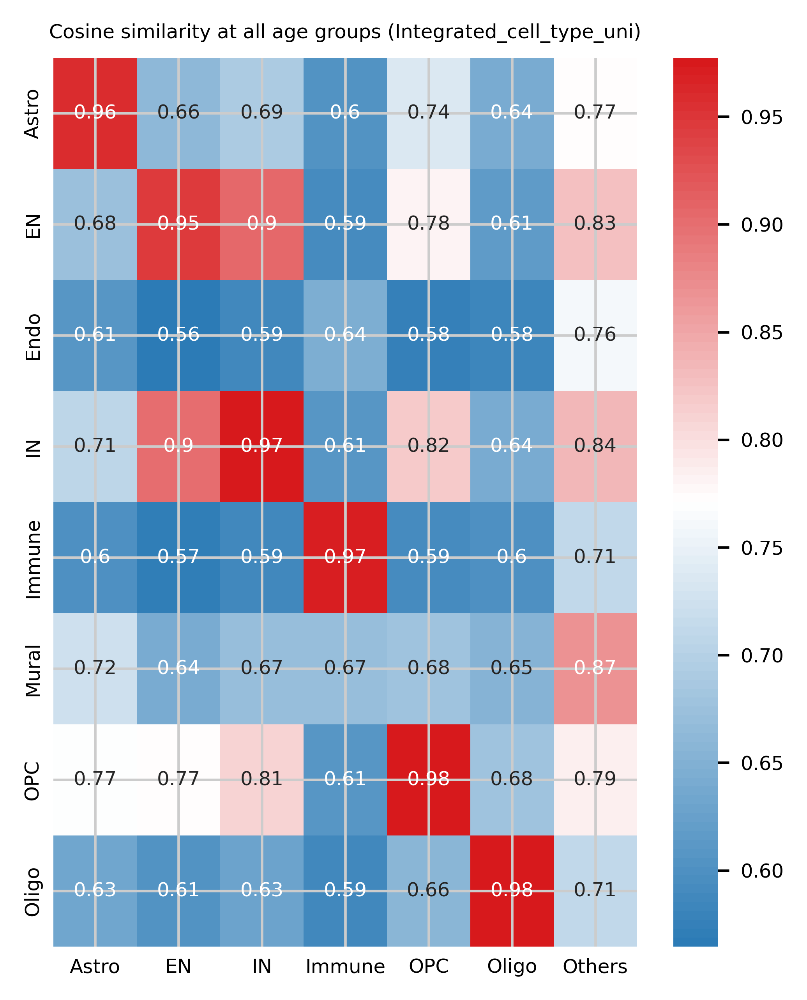

In [10]:
similarity_cell_type_all(adata, 'cell_type_uni', 'Integrated_cell_type_uni', 10, 'integrated_data_similarity_two_cohorts_cell_type_uni_all.pdf')


# Obtain lineage and merge annotations

In [29]:
ad_en = adata[adata.obs['cell_type_uni'] == 'EN', :]
ad_en # 349,350 × 14,668

View of AnnData object with n_obs × n_vars = 349350 × 14668
    obs: 'Batch', 'SubID', 'Age', 'Sex', 'PMI', 'cell_type_uni', 'subclass_uni', 'subtype_uni', 'dev_mat_uni', 'numerical_age', 'stage_id', 'Channel', 'Source', 'poolID', 'prep', 'rep', 'class', 'subclass', 'subtype', 'RL#', 'age', 'chem', 'concat_id', 'Race', 'Brain Regions*', 'Cause of Death', 'ICD-10 Code', 'ICD-10 category', 'Oxygen/No Oxygen', 'Date-of-Collection', 'Collection_year', 'Library Prep Date', 'Library Prep Lot', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'doublet_score', 'log10_gene_counts', 'log10_UMI_counts', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden', 'mat/dev', 'cell_type', 'major_clust', 'sub_clust'
    var: 'gene_id-Aging', 'gene_name-Aging', 'gene_type-Aging', 'gene_chrom-Aging', 'gene_start-Aging', 'gene_end-Aging', 'n_cells-Aging', 'percent_cells-Aging', 'robust-Aging', 'highly_variable_features-Aging', 'ribosomal-Aging', 'mitochondrial-Aging', 'pro

In [47]:
ad_en.obs['subclass_uni'].value_counts()

EN_L2_3_IT      148265
EN_L3_5_IT_3     40098
EN_L3_5_IT_2     39325
L2-3_CUX2        23665
EN_L6_IT_1       15499
EN_L3_5_IT_1     15010
L4_RORB          14465
EN_L6_CT         11639
EN_L6B            9563
L5-6_TLE4         8566
EN_L5_6_NP        7778
L5-6_THEMIS       7281
EN_L6_IT_2        4848
PN_dev            3048
EN_L5_ET           300
Name: subclass_uni, dtype: int64

In [39]:
ad_en.write('files/freeze3/aging_lister_integrated_ds1000_rmno_scanpy6000_half_100_123456_beforeUMAT_EN.h5ad')


## Basic UMAP and UMAT analysis

In [ ]:
%%sh

python ${dataPATH}/scripts/lineage_analysis_ryan_lister_fromLineageData.py \
-l ${dataPATH}/files/freeze3/aging_lister_integrated_ds1000_rmno_scanpy6000_half_100_123456_beforeUMAT_EN.h5ad \
-r 123456 \
-v scanpy@6000 \
-p half \
-n 25 \
-o ${dataPATH}/files/freeze3/aging_lister_integrated_ds1000_rmno_scanpy6000_half_100_123456_beforeUMAT_EN_scanpy6000_25_sparse_123456 \
-k no \
-s False

### 6000 hvgs

In [2]:
adata_6k = sc.read('files/freeze3/aging_lister_integrated_ds1000_rmno_scanpy6000_half_100_123456_beforeUMAT_EN_scanpy6000_25_sparse_123456_clustering.h5ad')
adata_6k # 349,350 × 14,649

AnnData object with n_obs × n_vars = 349350 × 14649
    obs: 'Batch', 'SubID', 'Age', 'Sex', 'PMI', 'cell_type_uni', 'subclass_uni', 'subtype_uni', 'dev_mat_uni', 'numerical_age', 'stage_id', 'Channel', 'Source', 'poolID', 'prep', 'rep', 'class', 'subclass', 'subtype', 'RL#', 'age', 'chem', 'concat_id', 'Race', 'Brain Regions*', 'Cause of Death', 'ICD-10 Code', 'ICD-10 category', 'Oxygen/No Oxygen', 'Date-of-Collection', 'Collection_year', 'Library Prep Date', 'Library Prep Lot', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'doublet_score', 'log10_gene_counts', 'log10_UMI_counts', 'percent_mito', 'percent_ribo', 'n_counts', 'leiden', 'mat/dev', 'cell_type', 'major_clust', 'sub_clust'
    var: 'gene_id-Aging', 'gene_name-Aging', 'gene_type-Aging', 'gene_chrom-Aging', 'gene_start-Aging', 'gene_end-Aging', 'n_cells-Aging', 'percent_cells-Aging', 'robust-Aging', 'highly_variable_features-Aging', 'ribosomal-Aging', 'mitochondrial-Aging', 'protein_cod

In [ ]:
from pandas.api.types import CategoricalDtype
adata_6k.obs['stage_id_ord'] = adata_6k.obs['stage_id']
cat_dtype = CategoricalDtype(categories=adata_6k.uns['stage_order'], ordered=True)
adata_6k.obs['stage_id_ord'] = adata_6k.obs['stage_id_ord'].astype(cat_dtype)

#### subclass_uni_plot

In [3]:
spec_subclasses = ['EN_L6B', 'EN_L6_CT', 'EN_L5_6_NP', 'EN_L5_ET', 'EN_L6_IT_1', 'EN_L6_IT_2', 'EN_L3_5_IT_1', 'EN_L3_5_IT_2', 'EN_L3_5_IT_3', 'EN_L2_3_IT']
adata_6k.obs['subclass_uni_plot'] = pd.NA
condition = ((adata_6k.obs['numerical_age'] >= 20) & (adata_6k.obs['subclass_uni'].isin(spec_subclasses))) | (adata_6k.obs['subclass_uni'].isin(['PN_dev']))
adata_6k.obs.loc[condition, 'subclass_uni_plot'] = adata_6k.obs.loc[condition, 'subclass_uni']

/sc/arion/work/yangh17/conda/envs/snRNAseq_py3.9/lib/python3.9/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/sc/arion/work/yangh17/conda/envs/snRNAseq_py3.9/lib/python3.9/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/sc/arion/work/yangh17/conda/envs/snRNAseq_py3.9/lib/python3.9/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/sc/arion/work/yangh17/conda/envs/snRNAseq_py3.9/lib/python3.9/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cma

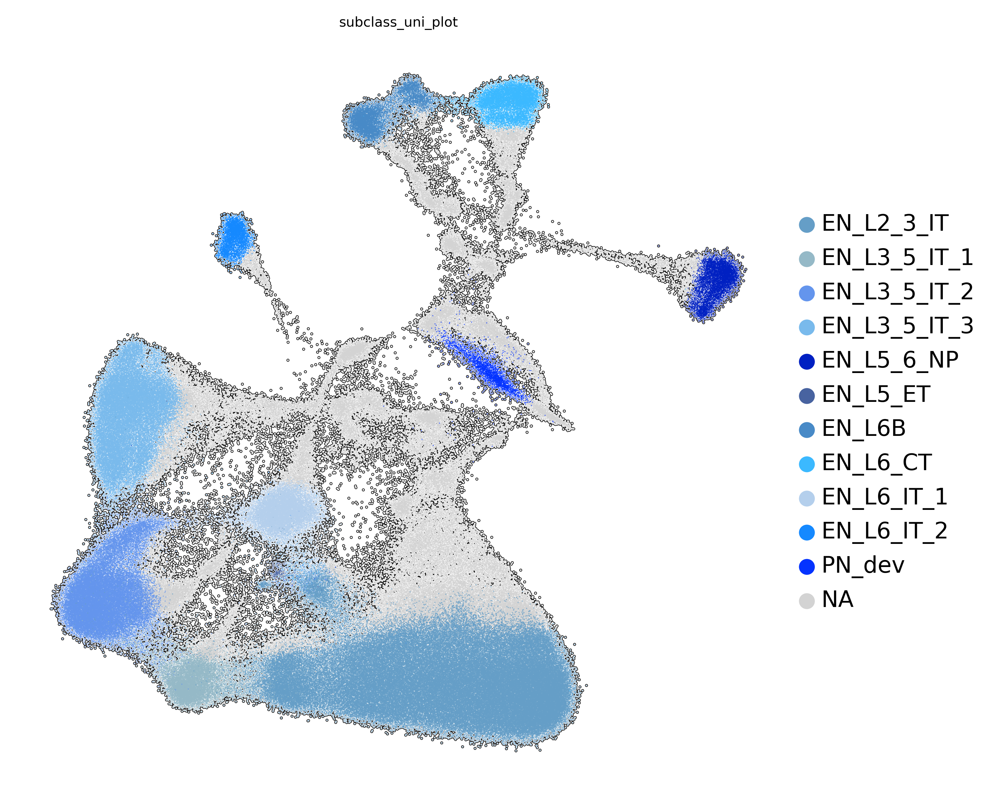

In [5]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.embedding(adata_6k, basis = 'umat', color='subclass_uni_plot', add_outline=True,cmap='vlag',#legend_loc='on data',
               legend_fontsize=10, legend_fontoutline=2,frameon=False, palette=colors_subclass,
               outline_width=(0.5, 0.3), vmin=0, vmax=1,size=1,
               return_fig=True)
plt.savefig('en_data_umat_subclass_uni_plot.pdf', transparent=True, format='pdf')

#### stage_id

In [6]:
from pandas.api.types import CategoricalDtype
adata_6k.obs['stage_id_ord'] = adata_6k.obs['stage_id']
cat_dtype = CategoricalDtype(categories=adata_6k.uns['stage_order'], ordered=True)
adata_6k.obs['stage_id_ord'] = adata_6k.obs['stage_id_ord'].astype(cat_dtype)

/sc/arion/work/yangh17/conda/envs/snRNAseq_py3.9/lib/python3.9/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/sc/arion/work/yangh17/conda/envs/snRNAseq_py3.9/lib/python3.9/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/sc/arion/work/yangh17/conda/envs/snRNAseq_py3.9/lib/python3.9/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/sc/arion/work/yangh17/conda/envs/snRNAseq_py3.9/lib/python3.9/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cma

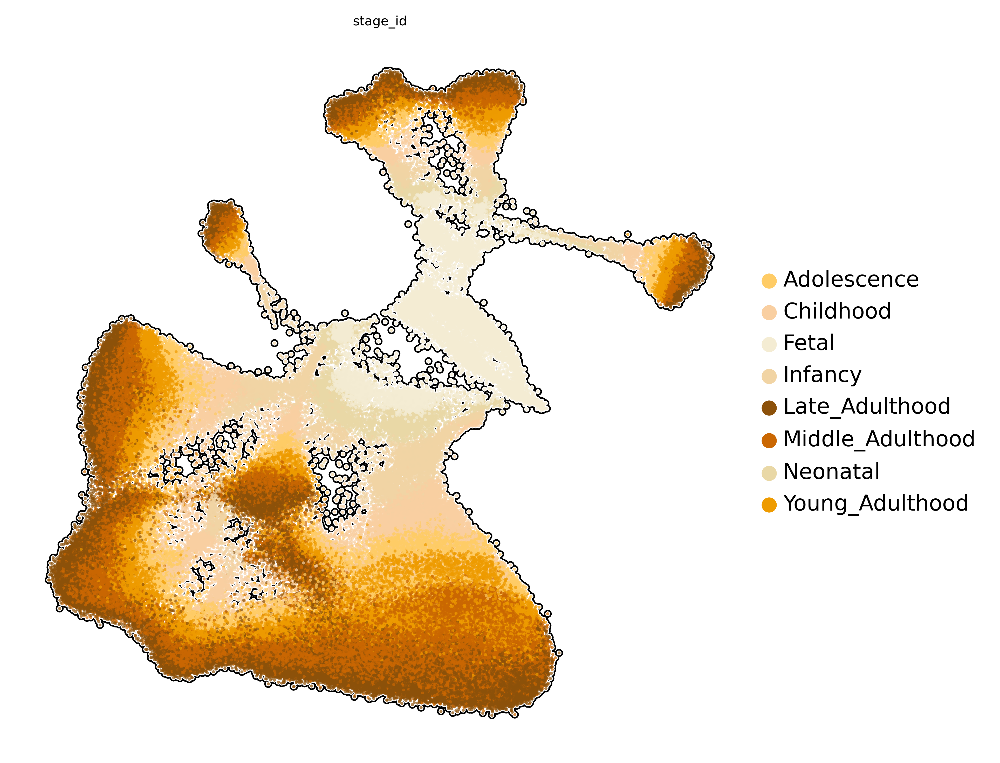

In [7]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.embedding(adata_6k, basis = 'umat', color='stage_id', add_outline=True,cmap='vlag',#legend_loc='on data',
               legend_fontsize=10, legend_fontoutline=2,frameon=False,palette=colors_stage_id,
               outline_width=(0.5, 0.3), vmin=0, vmax=1,size=8,
               return_fig=True)
# plt.savefig('files/freeze3/figures/en_data_umat_stage_id.pdf', transparent=True, format='pdf')

# Pseudotime infer

In [ ]:
%%sh
dataPATH=/sc/arion/projects/CommonMind/aging/hui

Rscript ${dataPATH}/scripts/freeze3/pseudotime_infer.R \
    ${dataPATH}/files/freeze3/aging_lister_integrated_ds1000_rmno_scanpy6000_half_100_123456_beforeUMAT_EN_scanpy6000_25_sparse_123456_clustering.h5ad \
    ${dataPATH}/files/freeze3/aging_lister_integrated_ds1000_rmno_scanpy6000_half_100_123456_beforeUMAT_EN_scanpy6000_25_sparse_123456 \
    12 \
    8

## Data visualization

In [4]:
cds <- readRDS("aging_lister_integrated_ds1000_rmno_scanpy6000_half_100_123456_beforeUMAT_EN_scanpy6000_25_sparse_123456_beforeConstruction_cds.RDS")
d <- readRDS("aging_lister_integrated_ds1000_rmno_scanpy6000_half_100_123456_beforeUMAT_EN_scanpy6000_25_sparse_123456_beforeConstruction_d.RDS")
print(cds)
print(head(d))

class: cell_data_set_ext 
dim: 14649 349350 
metadata(0):
assays(2): counts logcounts
rownames(14649): DPM1 SCYL3 ... OOSP1 C8orf44-SGK3
rowData names(2): gene_name gene_short_name
colnames(349350): H1007-1-AAACGAAAGTTGTAGA-0-Aging
  H1007-1-AAACGCTAGGAACGTC-0-Aging ...
  TTTGTTGCAACAGTGG-RL2132_25yr_v3-Lister
  TTTGTTGGTTCGGCTG-RL2132_25yr_v3-Lister
colData names(55): orig.ident nCount_RNA ... ident Size_Factor
reducedDimNames(1): UMAP
mainExpName: RNA
altExpNames(0):
       UMAP_1    UMAP_2
Y_1  3.353634 -2.586468
Y_2  6.660030 -2.664072
Y_3  5.710811 -3.244134
Y_4 -4.205581  4.064157
Y_5  6.741029 -2.410639
Y_6 -4.198869  5.435066


Warning message:
“Removed 1 rows containing missing values (`geom_text_repel()`).”


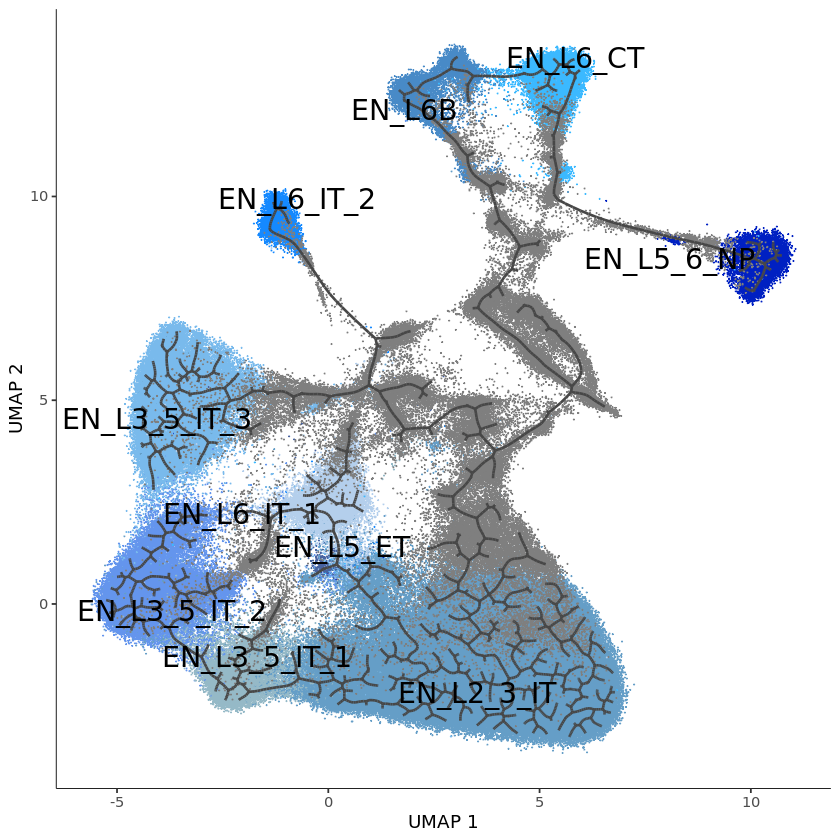

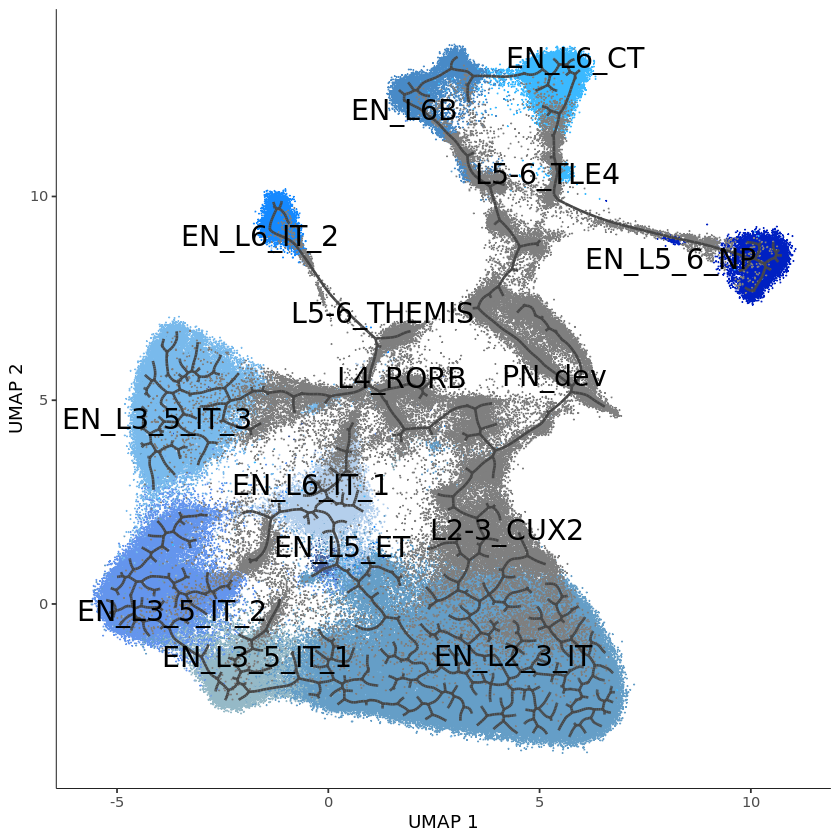

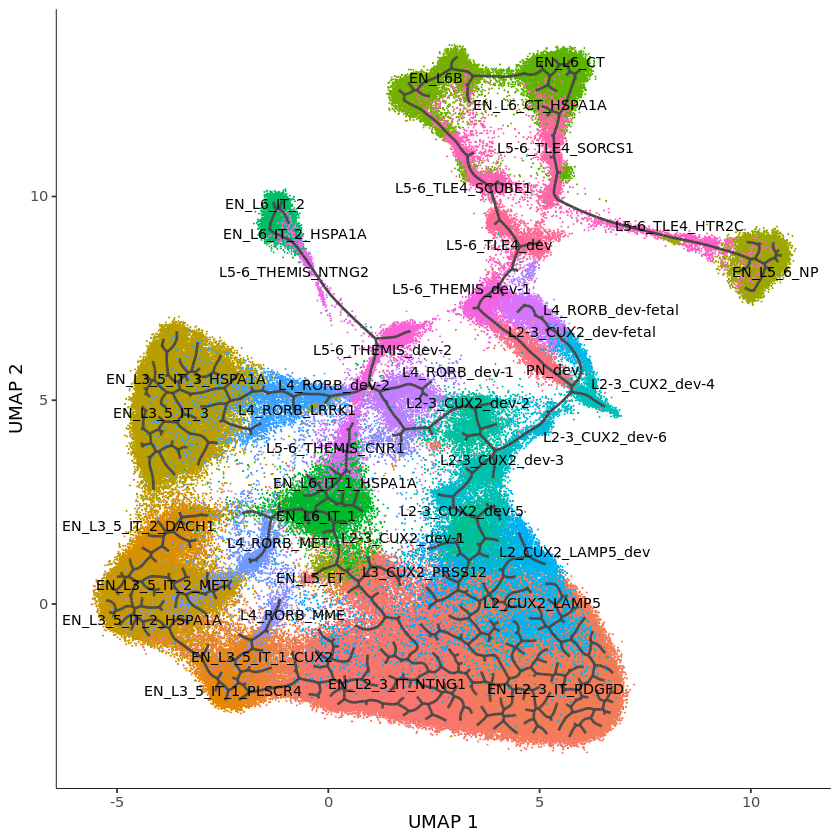

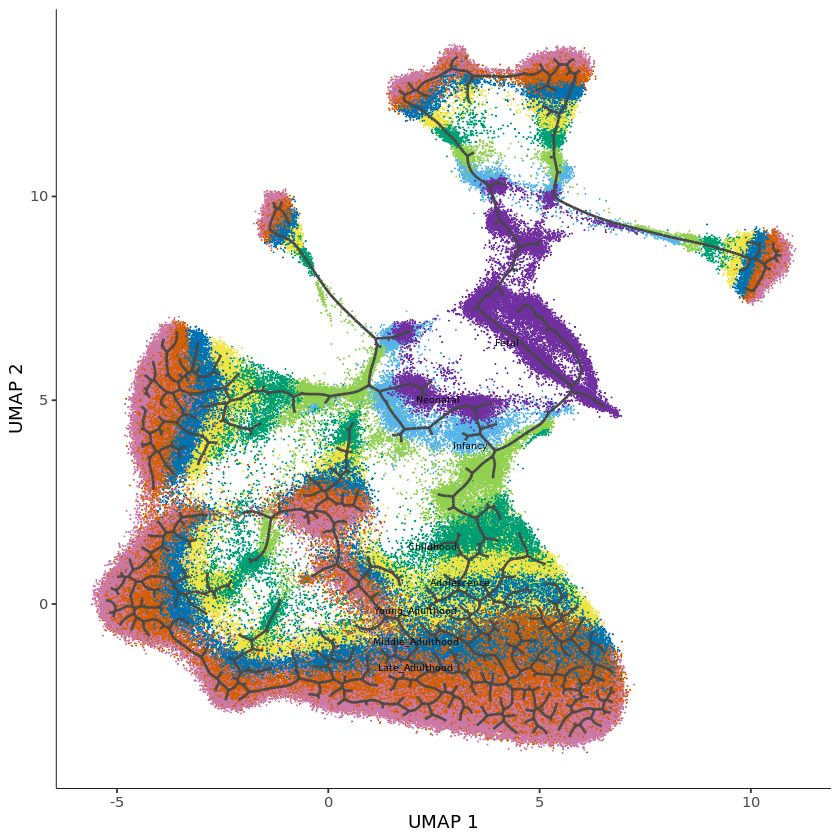

In [64]:
plot_cells(cds, color_cells_by = "subclass", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F, group_label_size = 6) + 
    scale_color_manual(values = cols_subclass_uni)

plot_cells(cds, color_cells_by = "subclass_uni", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F, group_label_size = 6) +
    scale_color_manual(values = cols_subclass_uni)

plot_cells(cds, color_cells_by = "subtype_uni", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F, group_label_size = 3)

plot_cells(cds, color_cells_by = "stage_id", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F) +
    scale_color_manual(values = cols_stage_id)

### Principle graphs

#### unit: 1000

In [ ]:
for(i in seq(0, 4, 1)){
    print(ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[(1000*i+1):min(1000*(i+1), 3575), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[(1000*i+1):min(1000*(i+1), 3575), ]), size=1, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1))
}


#### unit: 500

In [ ]:
for(i in seq(0, 8, 1)){
    print(ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[(500*i+1):min(500*(i+1), 3575), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[(500*i+1):min(500*(i+1), 3575), ]), size=1.5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1))
}

#### unit: 200

In [ ]:
for(i in seq(0, 18, 1)){
    print(ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[(200*i+1):min(200*(i+1), 3575), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[(200*i+1):min(200*(i+1), 3575), ]), size=1.5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1))
}

#### unit: 50

In [ ]:
for(i in seq(0, 73, 1)){
    print(ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[(50*i+1):min(50*(i+1), 3575), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[(50*i+1):min(50*(i+1), 3575), ]), size=4, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1))
}

### EN_L6B

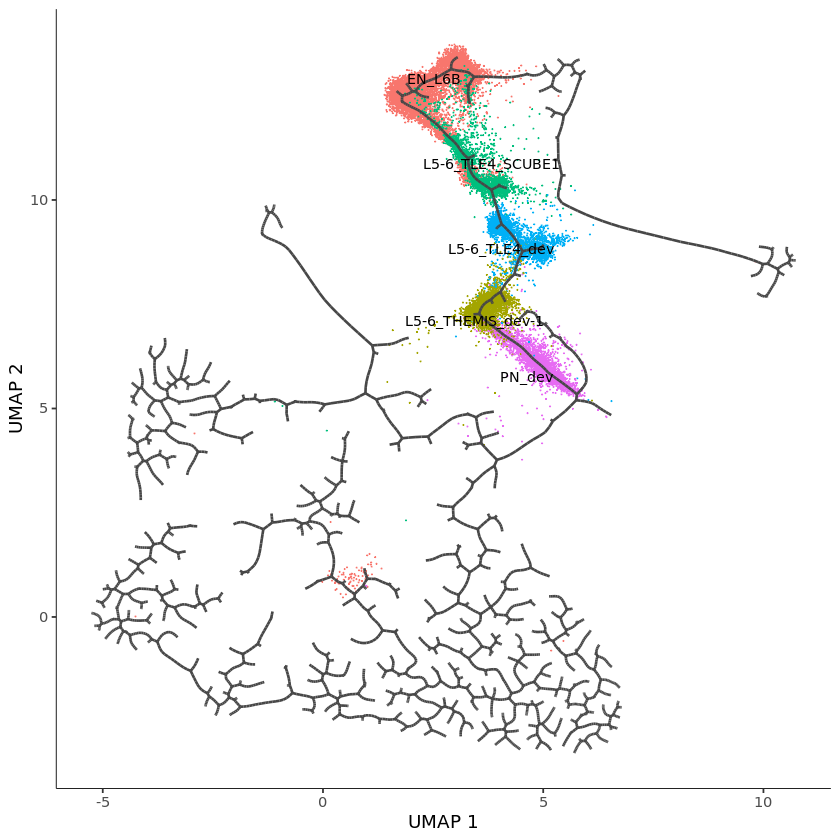

In [44]:
subtypes_to_keep <- c("PN_dev", "L5-6_THEMIS_dev-1", "L5-6_TLE4_dev", "L5-6_TLE4_SCUBE1", "EN_L6B")  # replace with your actual subtype_uni labels
cells_to_keep <- which(colData(cds)$subtype_uni %in% subtypes_to_keep)
cds_subset <- cds[, cells_to_keep]
plot_cells(cds_subset, color_cells_by = "subtype_uni", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F, group_label_size = 3)


### EN_L6_CT

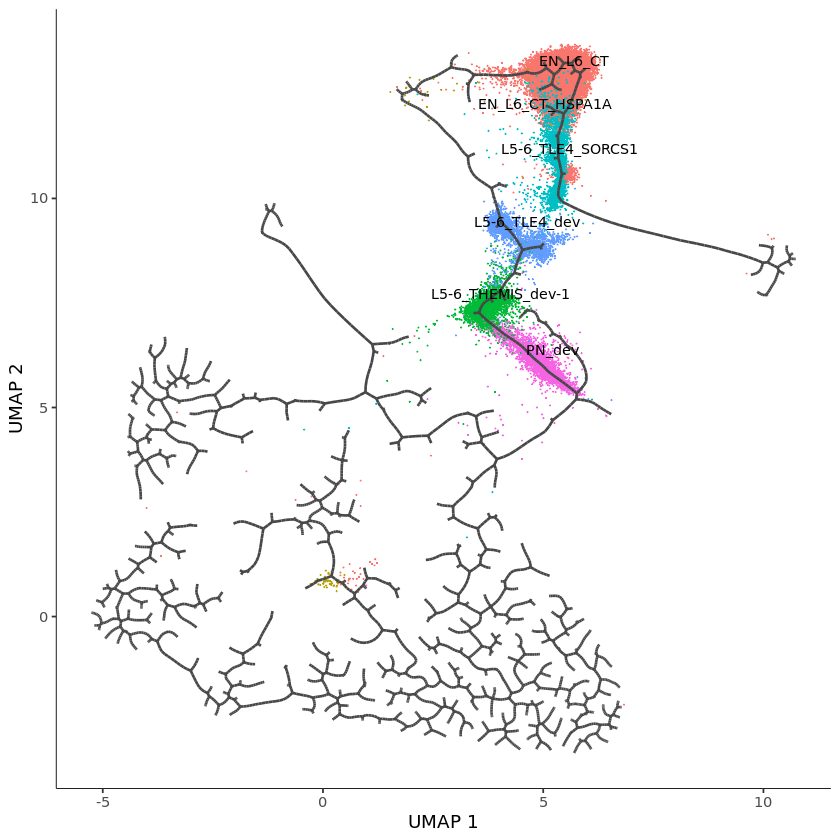

In [45]:
subtypes_to_keep <- c("PN_dev", "L5-6_THEMIS_dev-1", "L5-6_TLE4_dev", "L5-6_TLE4_SORCS1", "EN_L6_CT_HSPA1A", "EN_L6_CT")
cells_to_keep <- which(colData(cds)$subtype_uni %in% subtypes_to_keep)
cds_subset <- cds[, cells_to_keep]
plot_cells(cds_subset, color_cells_by = "subtype_uni", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F, group_label_size = 3)


### EN_L5_6_NP

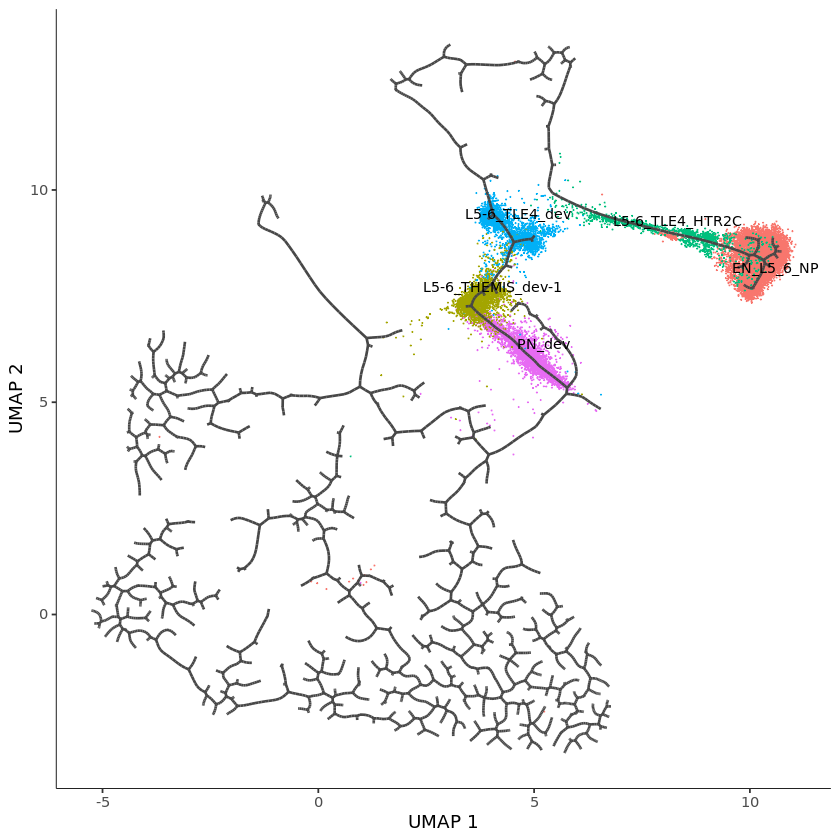

In [47]:
subtypes_to_keep <- c("PN_dev", "L5-6_THEMIS_dev-1", "L5-6_TLE4_dev", "L5-6_TLE4_HTR2C", "EN_L5_6_NP")
cells_to_keep <- which(colData(cds)$subtype_uni %in% subtypes_to_keep)
cds_subset <- cds[, cells_to_keep]
plot_cells(cds_subset, color_cells_by = "subtype_uni", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F, group_label_size = 3)


### EN_L6_IT_1

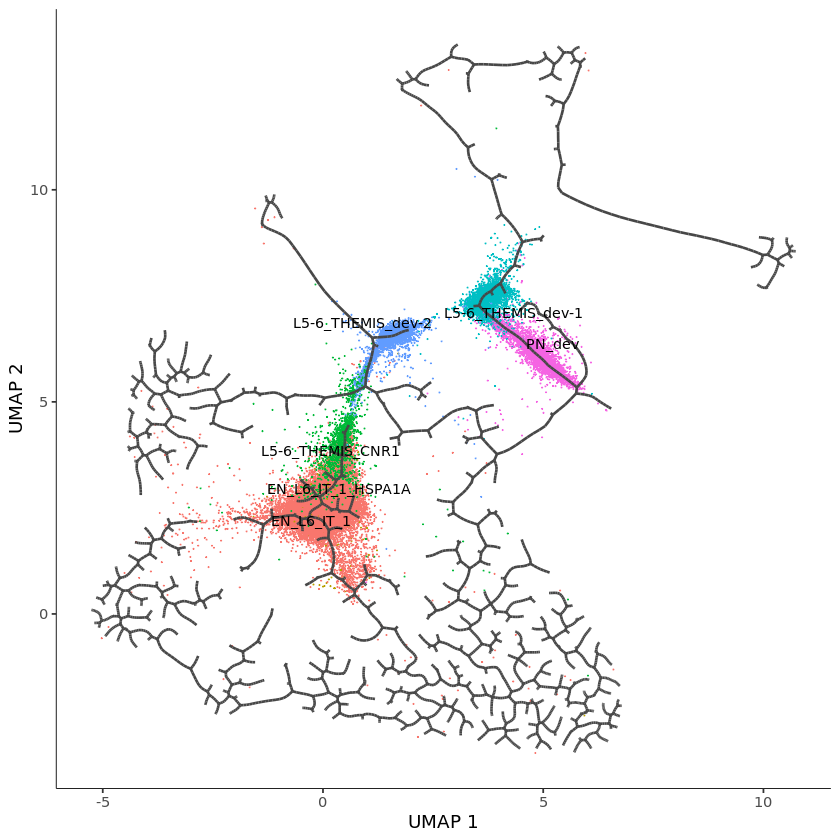

In [48]:
subtypes_to_keep <- c("PN_dev", "L5-6_THEMIS_dev-1", "L5-6_THEMIS_dev-2", "L5-6_THEMIS_CNR1", "EN_L6_IT_1_HSPA1A", "EN_L6_IT_1")
cells_to_keep <- which(colData(cds)$subtype_uni %in% subtypes_to_keep)
cds_subset <- cds[, cells_to_keep]
plot_cells(cds_subset, color_cells_by = "subtype_uni", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F, group_label_size = 3)


### EN_L6_IT_2

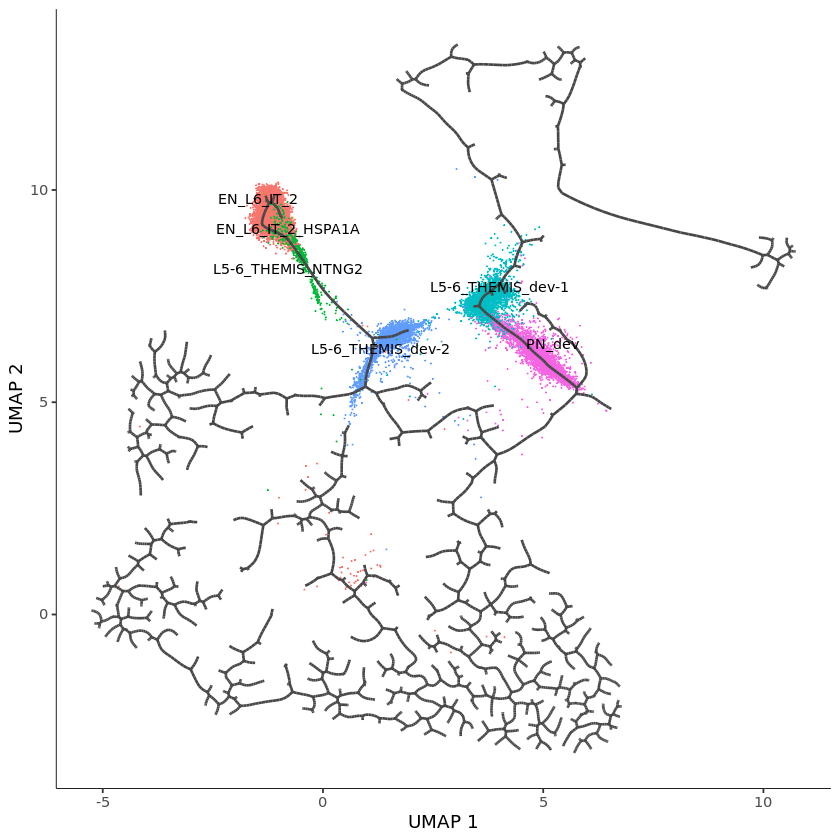

In [49]:
subtypes_to_keep <- c("PN_dev", "L5-6_THEMIS_dev-1", "L5-6_THEMIS_dev-2", "L5-6_THEMIS_NTNG2", "EN_L6_IT_2_HSPA1A", "EN_L6_IT_2")
cells_to_keep <- which(colData(cds)$subtype_uni %in% subtypes_to_keep)
cds_subset <- cds[, cells_to_keep]
plot_cells(cds_subset, color_cells_by = "subtype_uni", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F, group_label_size = 3)


### EN_L3_5_IT_3

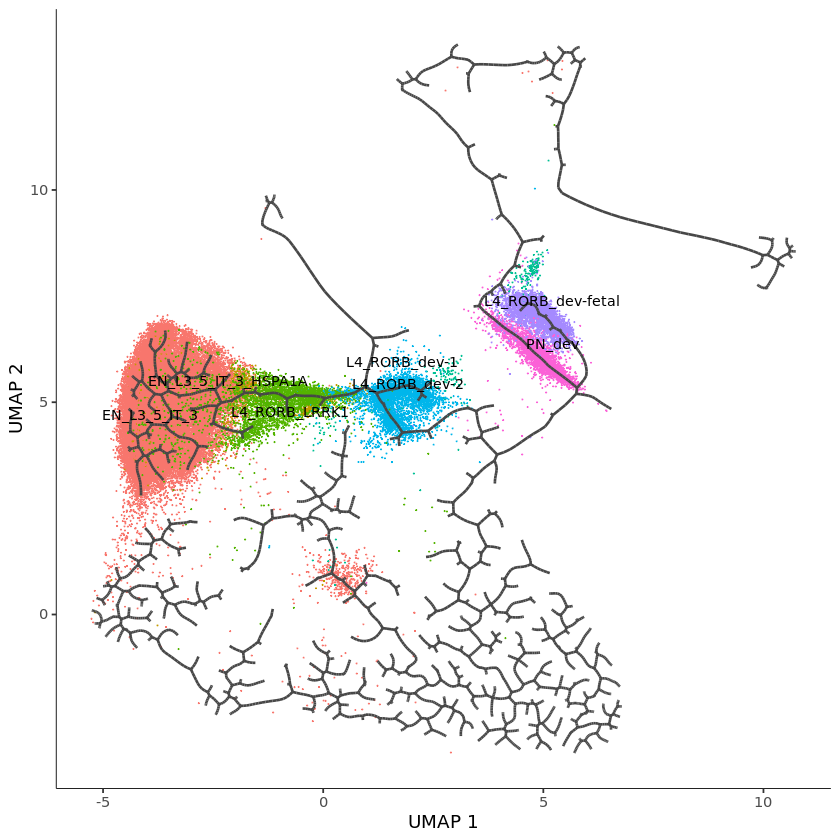

In [54]:
subtypes_to_keep <- c("PN_dev", "L4_RORB_dev-fetal", "L4_RORB_dev-1", "L4_RORB_dev-2", "L4_RORB_LRRK1", "EN_L3_5_IT_3_HSPA1A", "EN_L3_5_IT_3")
cells_to_keep <- which(colData(cds)$subtype_uni %in% subtypes_to_keep)
cds_subset <- cds[, cells_to_keep]
plot_cells(cds_subset, color_cells_by = "subtype_uni", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F, group_label_size = 3)


### EN_L3_5_IT_2

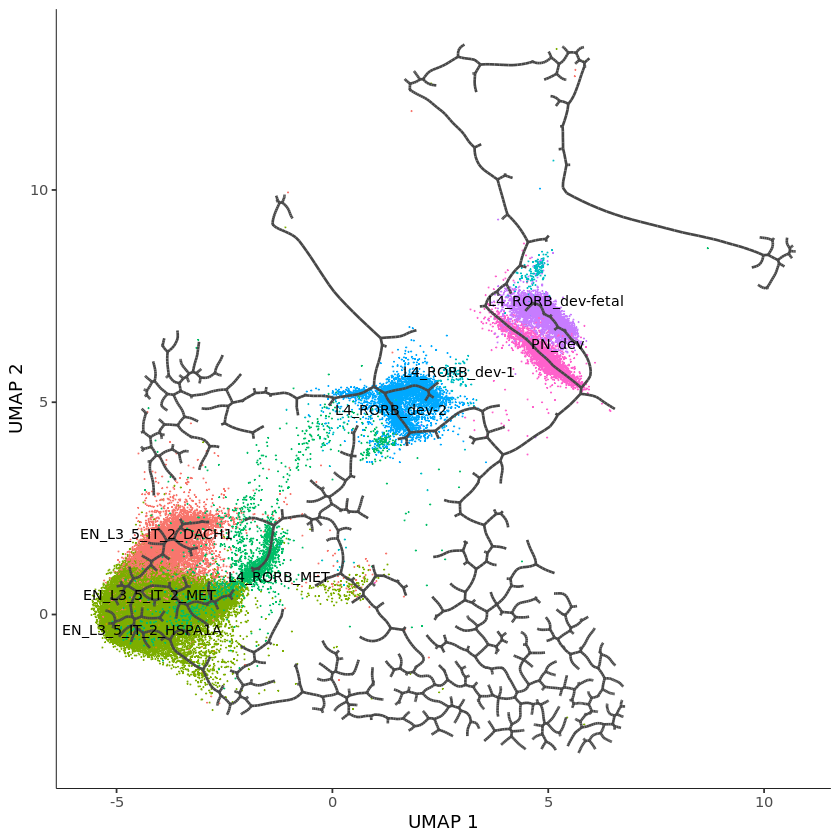

In [53]:
subtypes_to_keep <- c("PN_dev", "L4_RORB_dev-fetal", "L4_RORB_dev-1", "L4_RORB_dev-2", "L4_RORB_MET", "EN_L3_5_IT_2_MET", "EN_L3_5_IT_2_HSPA1A", "EN_L3_5_IT_2_DACH1")
cells_to_keep <- which(colData(cds)$subtype_uni %in% subtypes_to_keep)
cds_subset <- cds[, cells_to_keep]
plot_cells(cds_subset, color_cells_by = "subtype_uni", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F, group_label_size = 3)


### EN_L3_5_IT_1

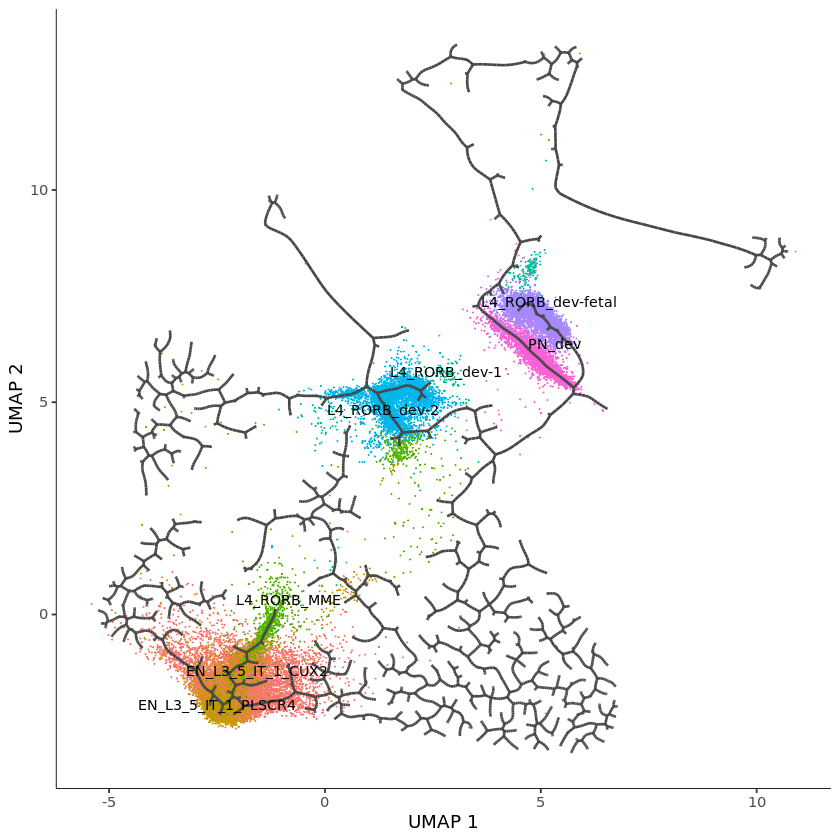

In [52]:
subtypes_to_keep <- c("PN_dev", "L4_RORB_dev-fetal", "L4_RORB_dev-1", "L4_RORB_dev-2", "L4_RORB_MME", "EN_L3_5_IT_1_CUX2", "EN_L3_5_IT_1_PLSCR4")
cells_to_keep <- which(colData(cds)$subtype_uni %in% subtypes_to_keep)
cds_subset <- cds[, cells_to_keep]
plot_cells(cds_subset, color_cells_by = "subtype_uni", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F, group_label_size = 3)


### EN_L2_3_IT

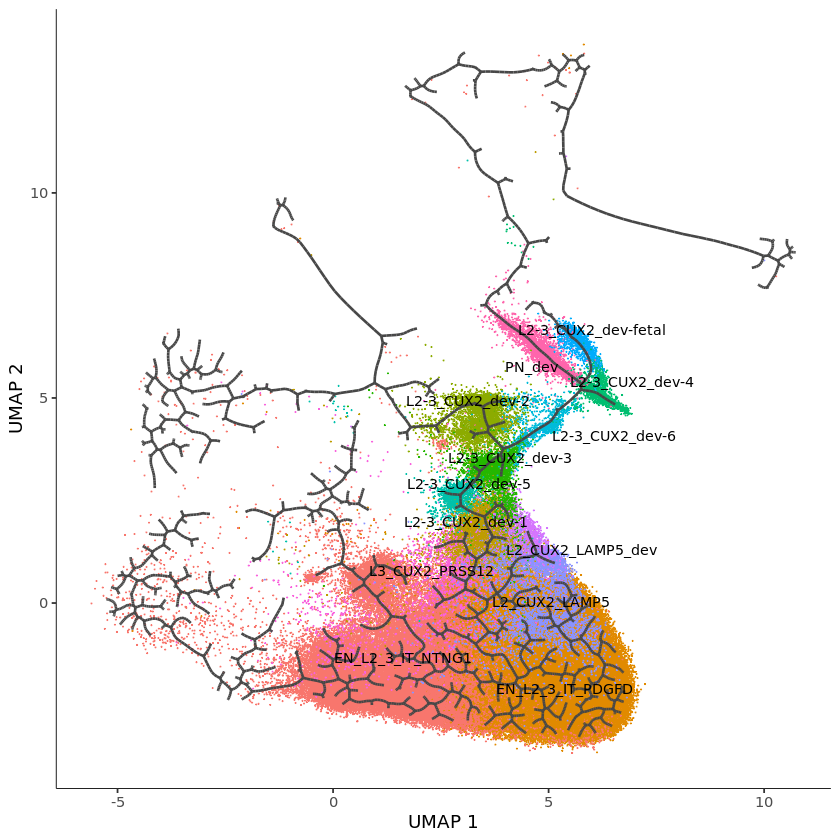

In [50]:
subtypes_to_keep <- c("PN_dev", "L2-3_CUX2_dev-fetal", "L2-3_CUX2_dev-4", "L2-3_CUX2_dev-6", "L2-3_CUX2_dev-2", "L2-3_CUX2_dev-3", "L2-3_CUX2_dev-5", "L2-3_CUX2_dev-1", "L2_CUX2_LAMP5_dev", "L2_CUX2_LAMP5", "L3_CUX2_PRSS12", "EN_L2_3_IT_NTNG1", "EN_L2_3_IT_PDGFD")
cells_to_keep <- which(colData(cds)$subtype_uni %in% subtypes_to_keep)
cds_subset <- cds[, cells_to_keep]
plot_cells(cds_subset, color_cells_by = "subtype_uni", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F, group_label_size = 3)


## Start and terminal points

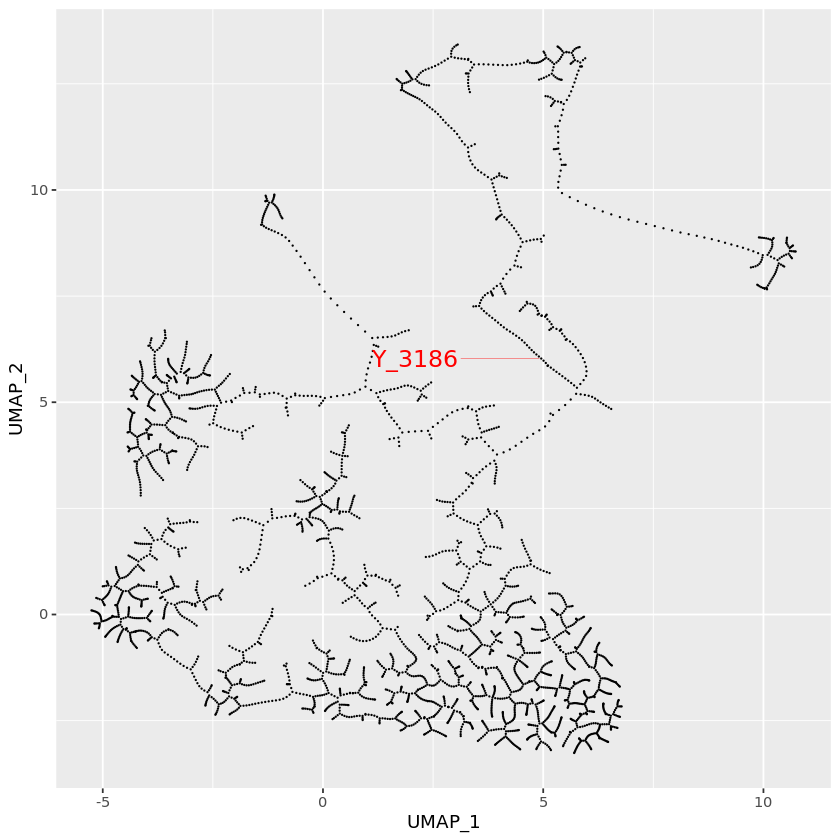

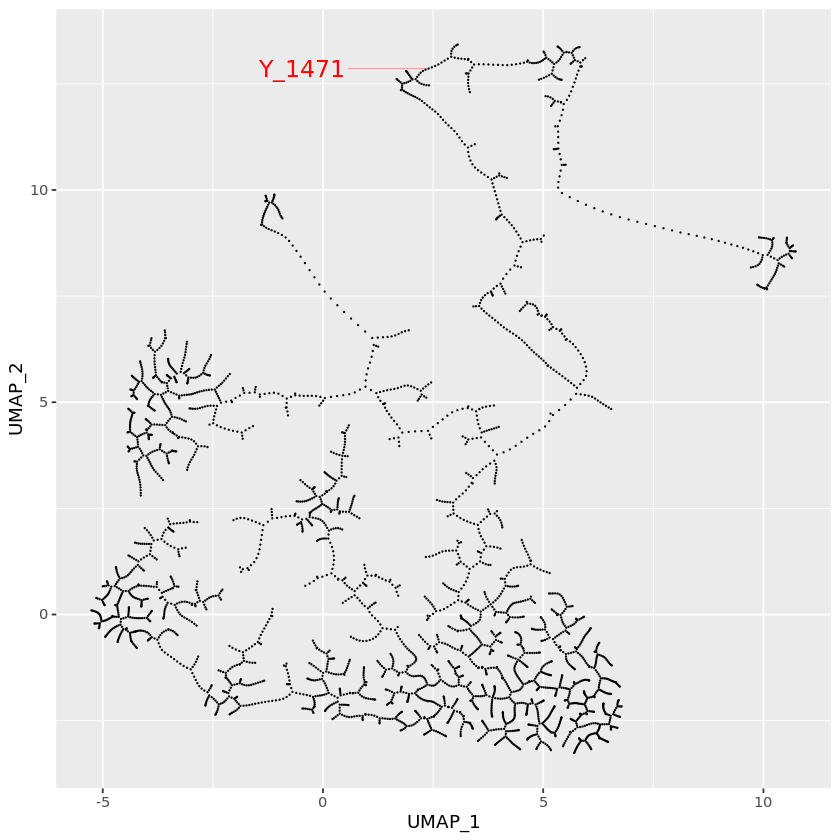

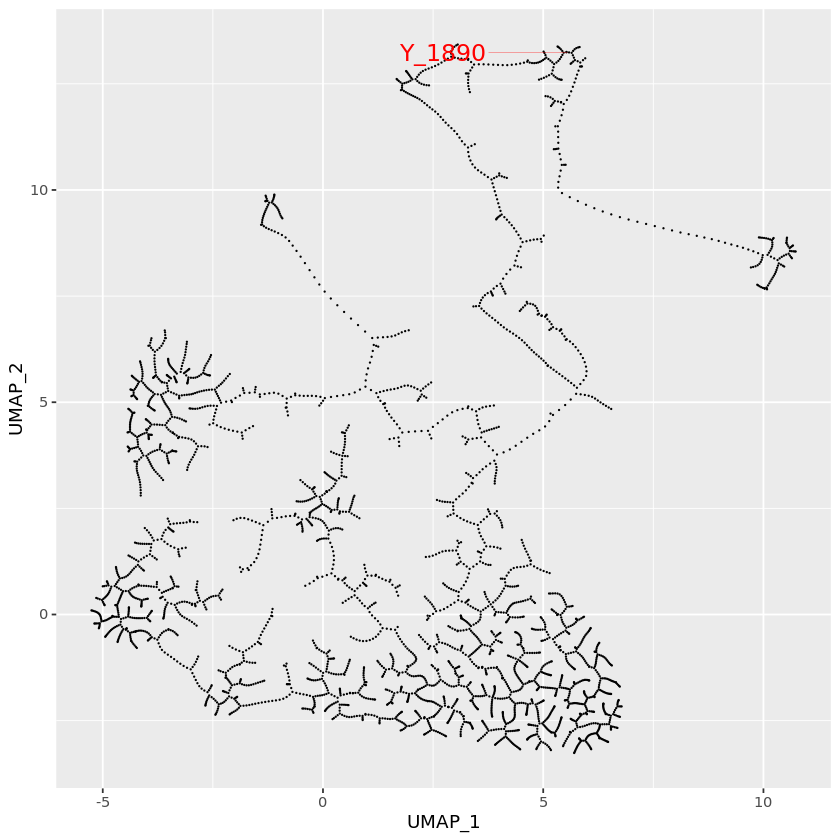

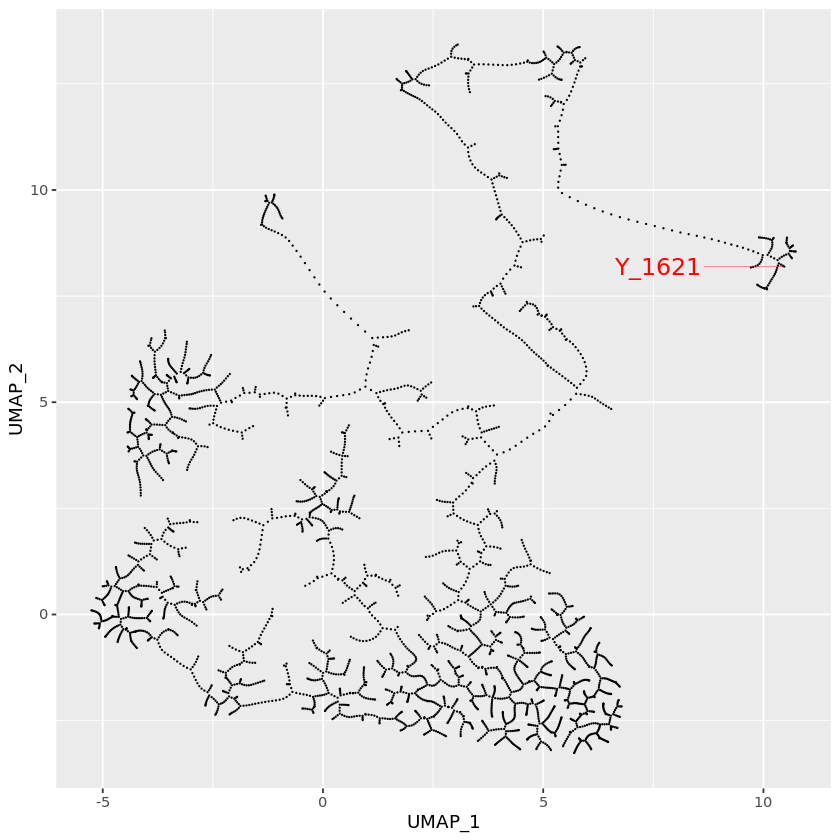

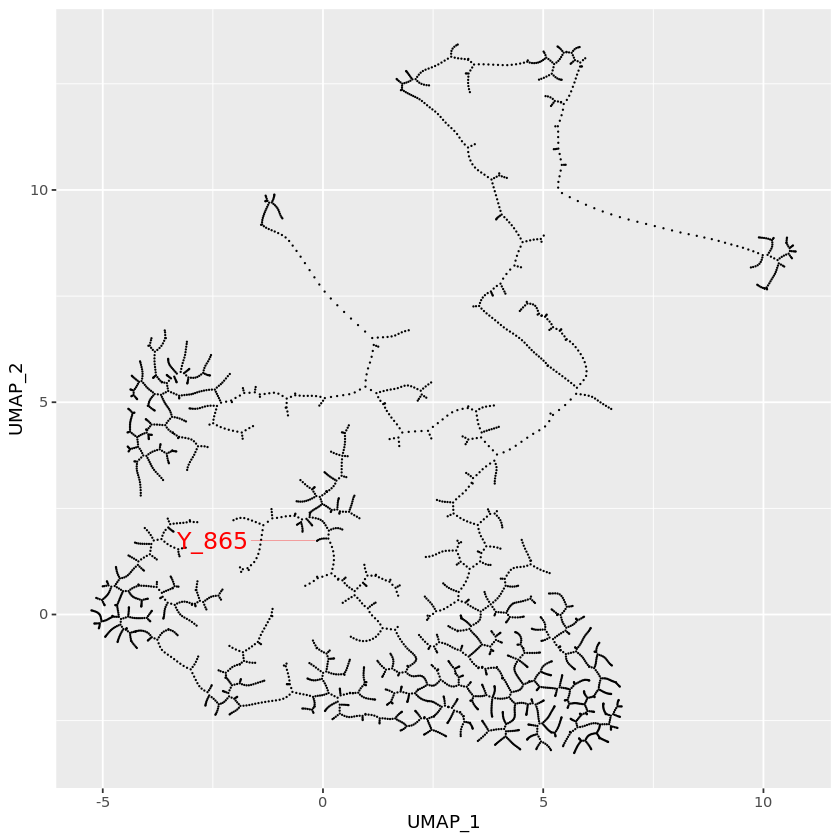

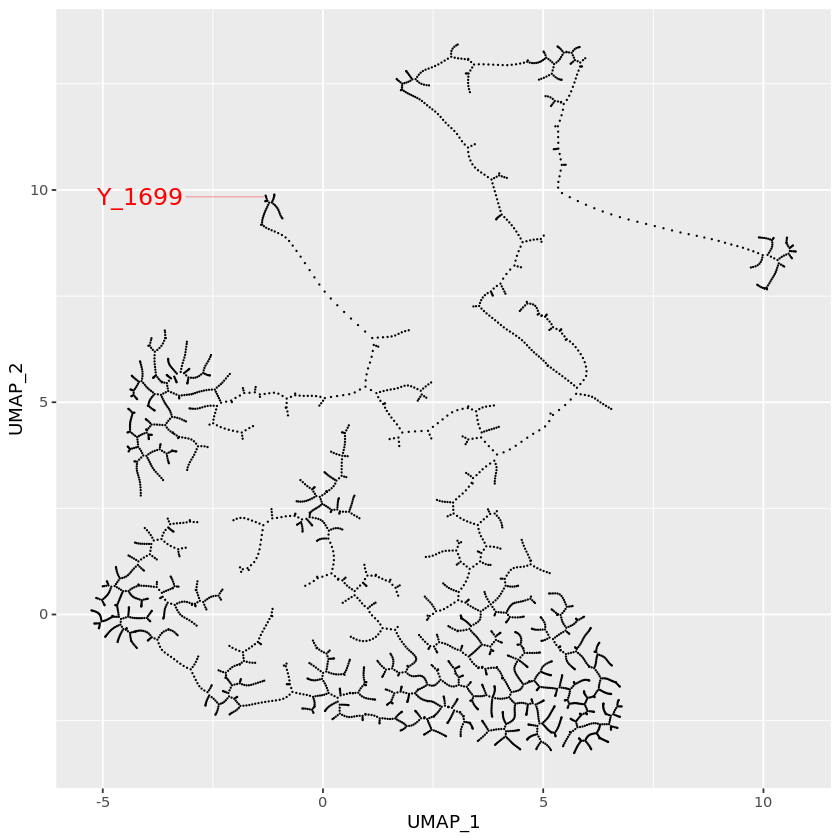

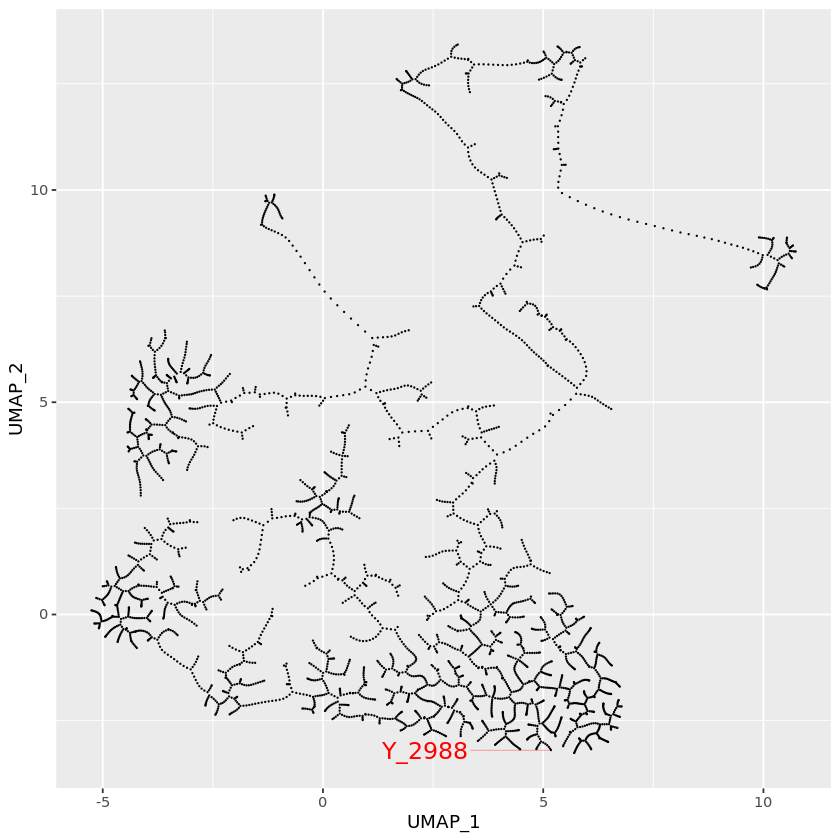

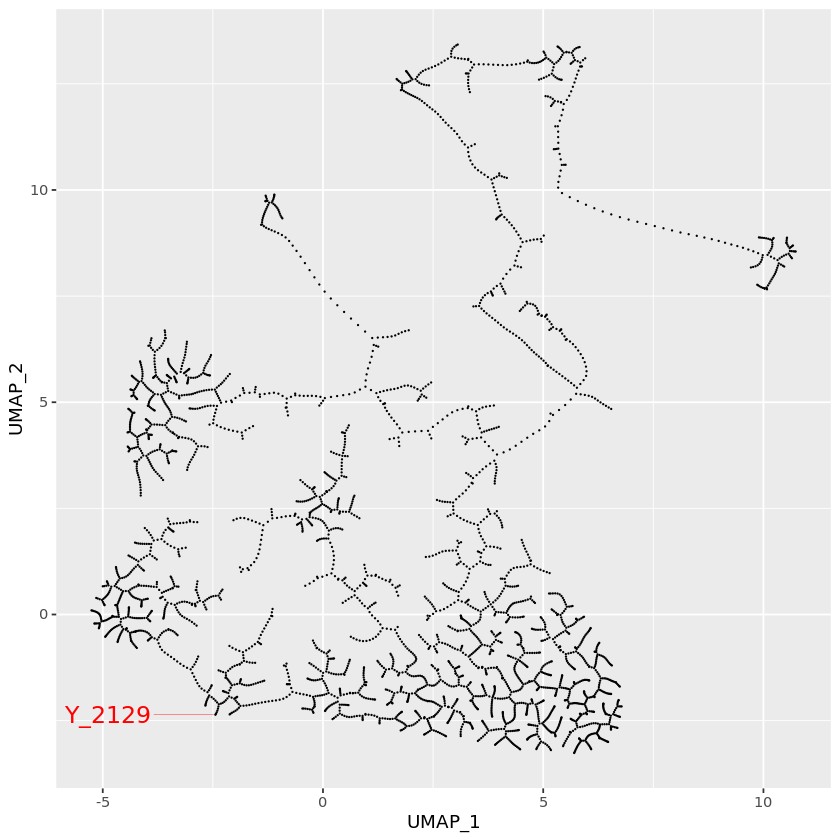

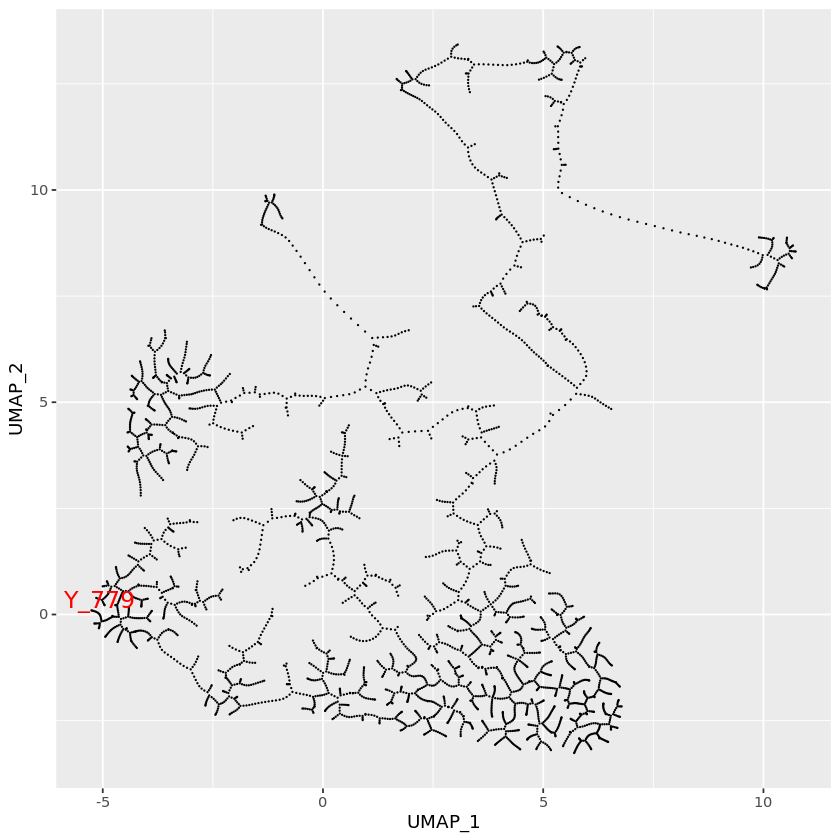

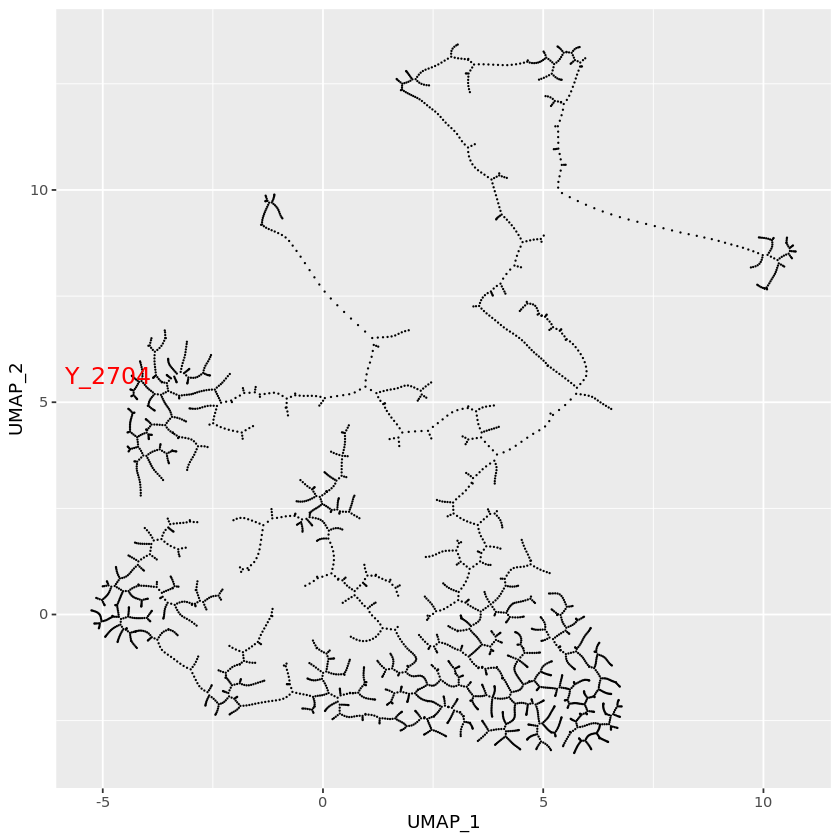

In [5]:
# start
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(3186), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(3186), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L6B
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(1471), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(1471), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L6_CT
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(1890), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(1890), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L5_6_NP
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(1621), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(1621), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L6_IT_1
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(865), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(865), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L6_IT_2
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(1699), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(1699), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L2_3_IT
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(2988), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(2988), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L3_5_IT_1
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(2129), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(2129), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L3_5_IT_2
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(779), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(779), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L3_5_IT_3
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(2704), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(2704), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)


## Node connection

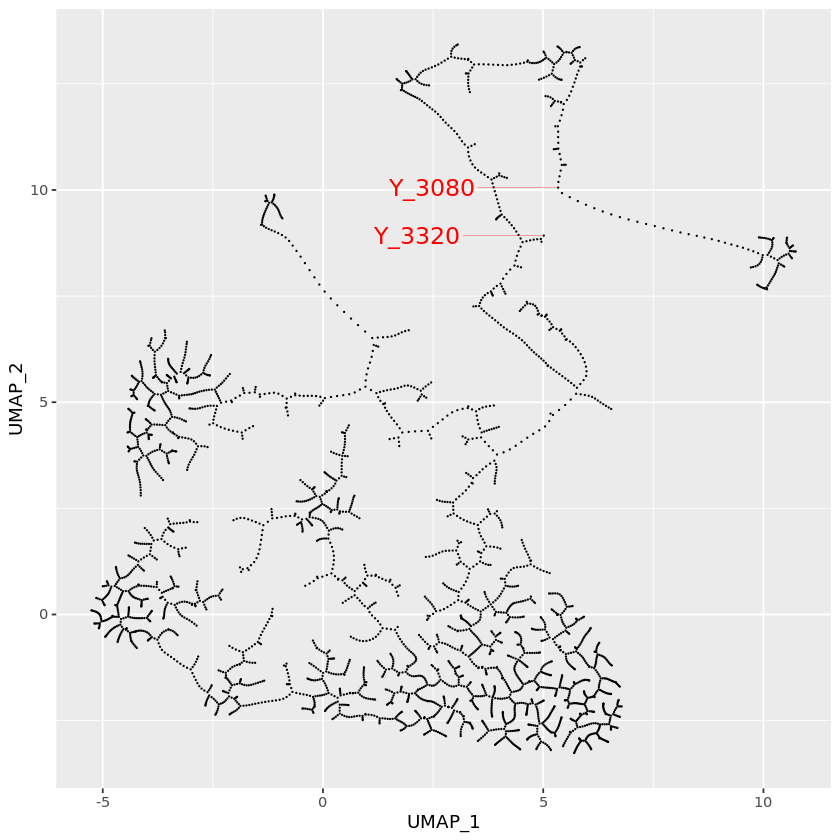

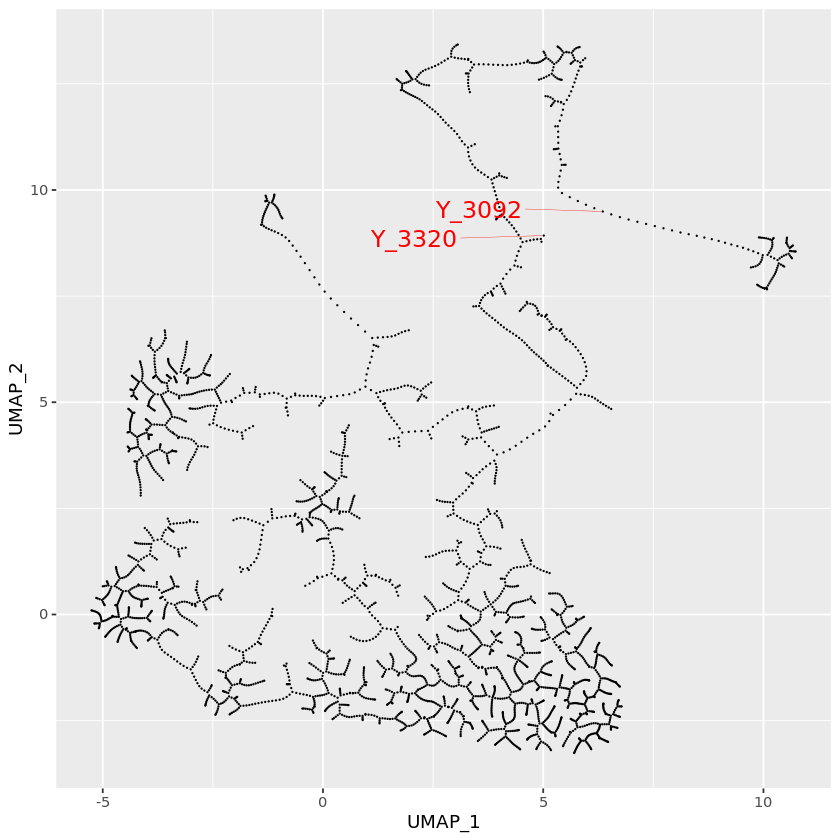

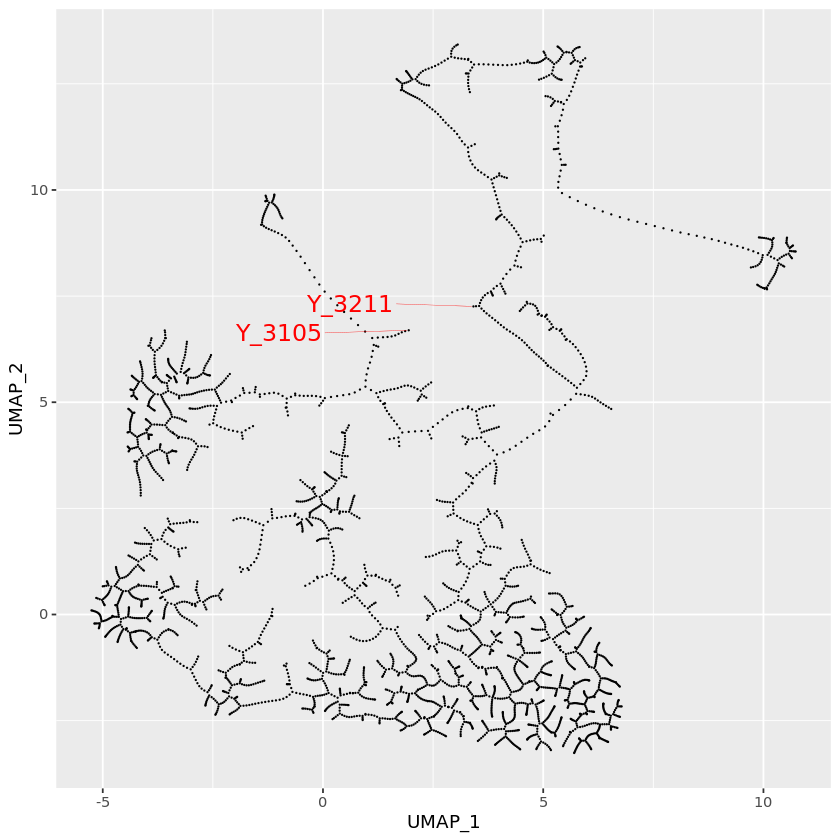

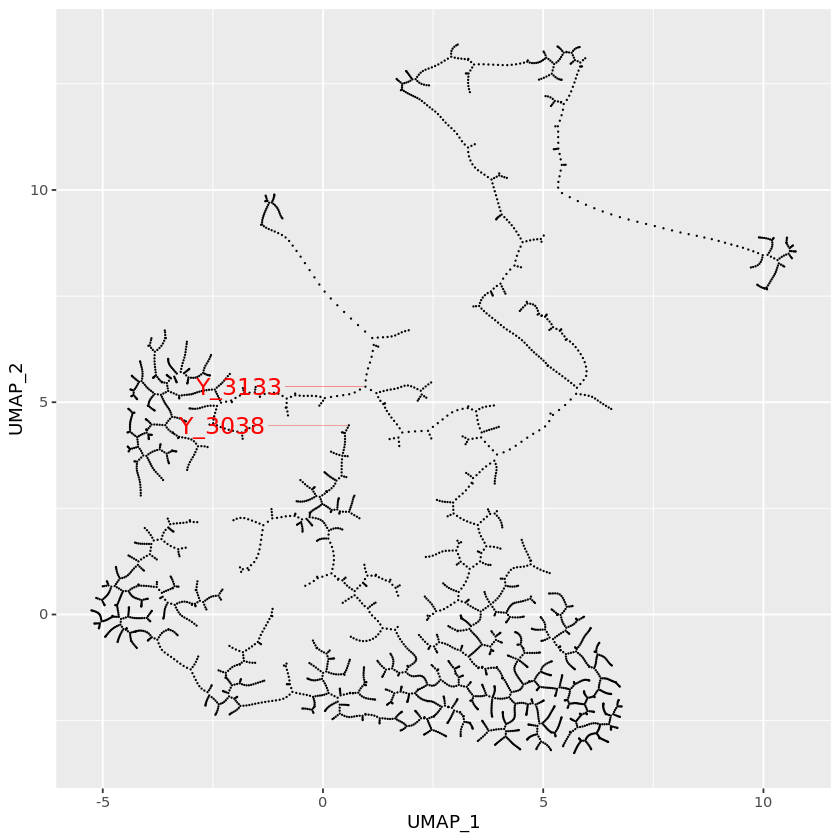

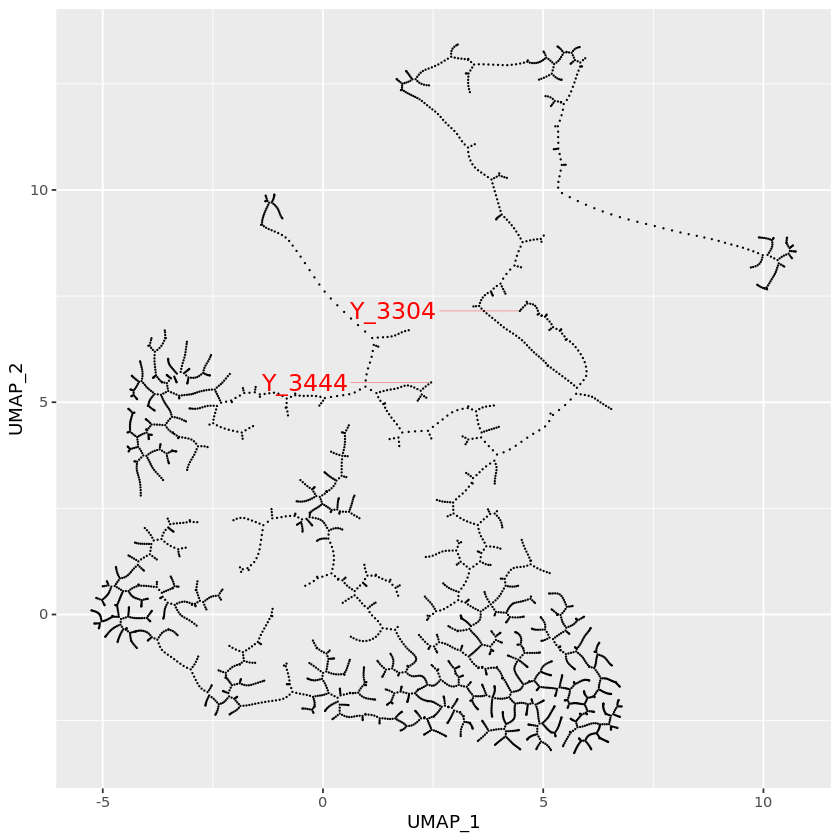

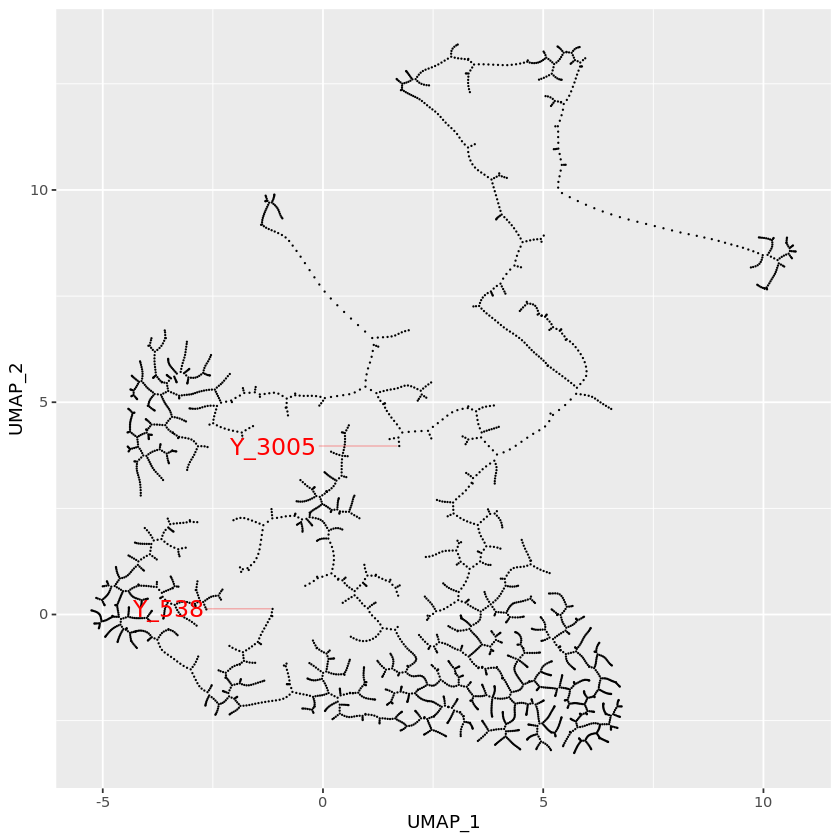

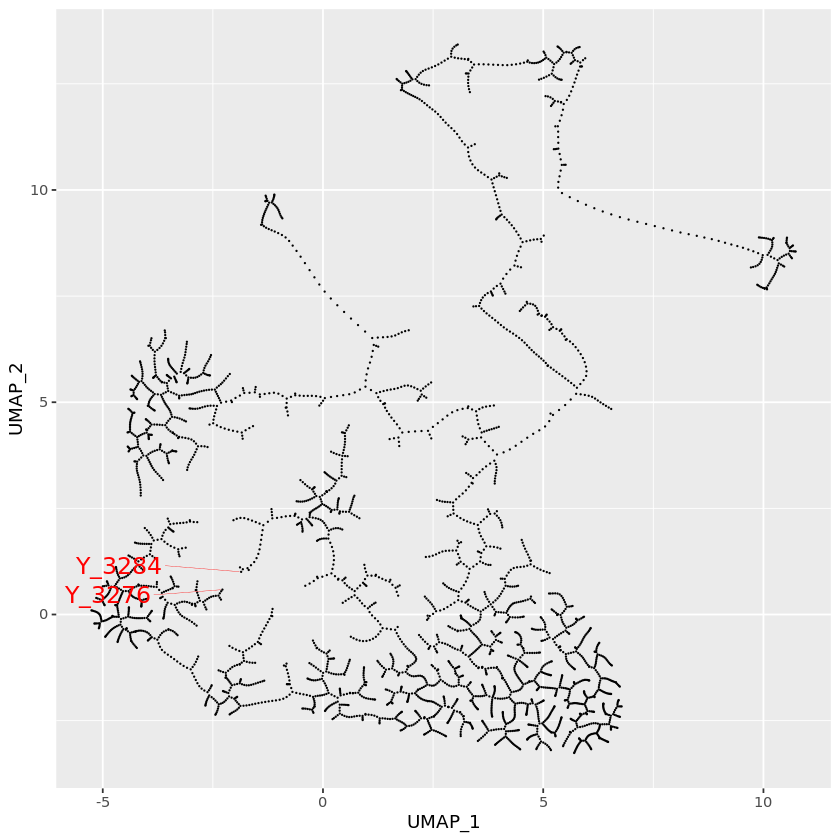

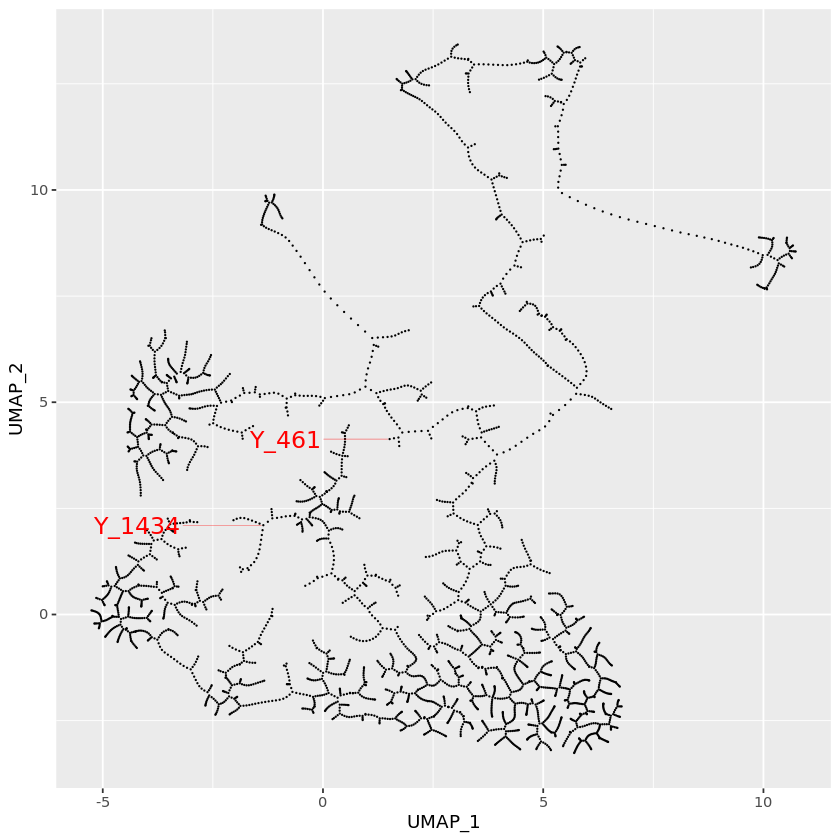

In [8]:
# L6B: no need to connect

# L6_CT
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(3320, 3080), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(3320, 3080), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L5_6_NP
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(3320, 3092), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(3320, 3092), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# deep_IT (L6_IT)
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(3211, 3105), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(3211, 3105), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L6_IT_2
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(3133, 3038), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(3133, 3038), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L3_5_IT
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(3304, 3444), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(3304, 3444), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L3_5_IT_1 (*)
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(3005, 538), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(3005, 538), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L3_5_IT_2
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(3284, 3276), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(3284, 3276), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(461, 1434), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(461, 1434), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)

# L3_5_IT_3: no need to connect


## Included nodes

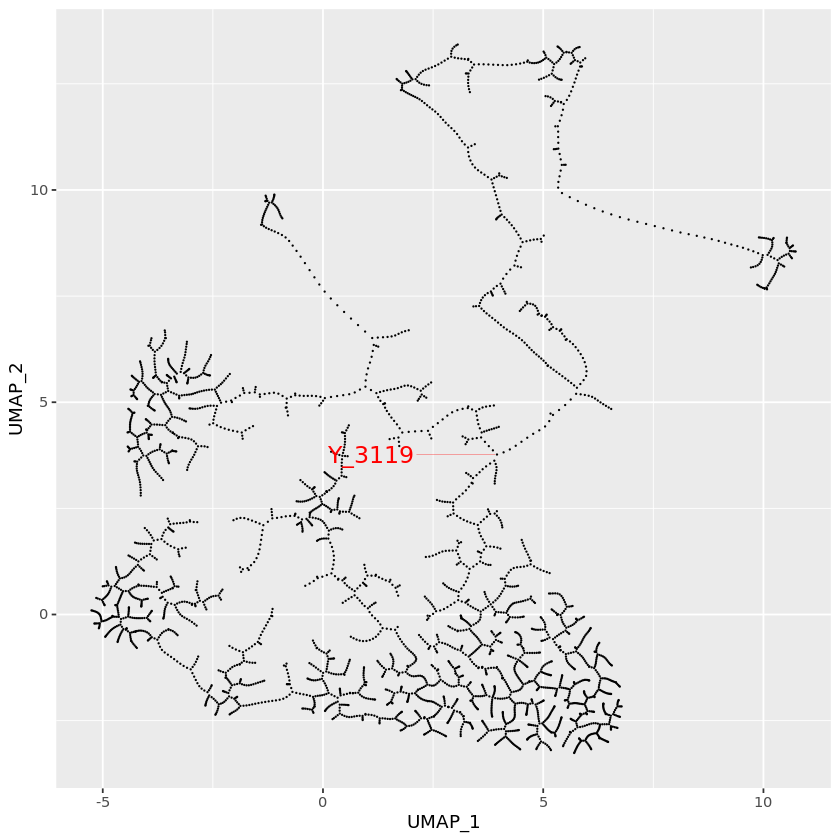

In [61]:
# L2_3_IT
ggplot(data=d, aes(x=UMAP_1, y=UMAP_2)) + geom_point(size=0.01) + geom_text_repel(data=d[c(3119), ], aes(x=UMAP_1, y=UMAP_2), label=rownames(d[c(3119), ]), size=5, hjust = 2, color = "red", max.overlaps = Inf, segment.size = 0.1)


## Reconstruction

In [ ]:
# connect nodes
# L6_CT
cds = connect_nodes(cds, "Y_3320", "Y_3080")

# L5_6_NP
cds = connect_nodes(cds, "Y_3320", "Y_3092")

# deep_IT (L6_IT)
cds = connect_nodes(cds, "Y_3211", "Y_3105")

# L6_IT_2
cds = connect_nodes(cds, "Y_3133", "Y_3038")

# L3_5_IT
cds = connect_nodes(cds, "Y_3186", "Y_3444")

# L3_5_IT_1 
cds = connect_nodes(cds, "Y_3005", "Y_538")

# L3_5_IT_2
cds = connect_nodes(cds, "Y_3284", "Y_3276") 
cds = connect_nodes(cds, "Y_461", "Y_1434")

# select individual lineages
# EN_L6B
lineage <- "EN_L6B"
print(lineage)
start <- 3186
end <- 1471
cds <- isolate_graph(cds, start, end, lineage)
sel.cluster <- c("PN_dev", "L5-6_THEMIS_dev-1", "L5-6_TLE4_dev", "L5-6_TLE4_SCUBE1", "EN_L6B")
cds <- isolate_lineage(cds, lineage, sel_clusters = sel.cluster, cl = 25, N = 10)


# EN_L6_CT
lineage <- "EN_L6_CT"
print(lineage)
end <- 1890
inc.node <- c("Y_3080")
cds <- isolate_graph(cds, start, end, lineage, include_nodes = inc.node)
sel.cluster <- c("PN_dev", "L5-6_THEMIS_dev-1", "L5-6_TLE4_dev", "L5-6_TLE4_SORCS1", "EN_L6_CT_HSPA1A", "EN_L6_CT")
cds <- isolate_lineage(cds, lineage, sel_clusters = sel.cluster, cl = 25, N = 10)

# EN_L5_6_NP
lineage <- "EN_L5_6_NP"
print(lineage)
end <- 1621
inc.node <- c("Y_3092")
cds <- isolate_graph(cds, start, end, lineage, include_nodes = inc.node)
sel.cluster <- c("PN_dev", "L5-6_THEMIS_dev-1", "L5-6_TLE4_dev", "L5-6_TLE4_HTR2C", "EN_L5_6_NP")
cds <- isolate_lineage(cds, lineage, sel_clusters = sel.cluster, cl = 25, N = 10)

# EN_L6_IT_1
lineage = "EN_L6_IT_1"
print(lineage)
end = 865
inc.node = c("Y_3105", "Y_3038")
cds <- isolate_graph(cds, start, end, lineage, include_nodes = inc.node)
sel.cluster = c("PN_dev", "L5-6_THEMIS_dev-1", "L5-6_THEMIS_dev-2", "L5-6_THEMIS_CNR1", "EN_L6_IT_1_HSPA1A", "EN_L6_IT_1")
cds <- isolate_lineage(cds, lineage, sel_clusters = sel.cluster, cl = 25, N = 10)

# EN_L6_IT_2
lineage <- "EN_L6_IT_2"
print(lineage)
end <- 1699
inc.node <- c("Y_3105")
cds <- isolate_graph(cds, start, end, lineage, include_nodes = inc.node)
sel.cluster <- c("PN_dev", "L5-6_THEMIS_dev-1", "L5-6_THEMIS_dev-2", "L5-6_THEMIS_NTNG2", "EN_L6_IT_2_HSPA1A", "EN_L6_IT_2")
cds <- isolate_lineage(cds, lineage, sel_clusters = sel.cluster, cl = 25, N = 10)

# EN_L3_5_IT_1
lineage <- "EN_L3_5_IT_1"
print(lineage)
end <- 2129
inc.node <- c("Y_538", "Y_3444") # inc.node <- c("Y_538", "Y_3005")
cds <- isolate_graph(cds, start, end, lineage, include_nodes = inc.node)
sel.cluster <- c("PN_dev", "L4_RORB_dev-fetal", "L4_RORB_dev-1", "L4_RORB_dev-2", "L4_RORB_MME", "EN_L3_5_IT_1_CUX2", "EN_L3_5_IT_1_PLSCR4")
cds <- isolate_lineage(cds, lineage, sel_clusters = sel.cluster, cl = 25, N = 10)

# EN_L3_5_IT_2
lineage <- "EN_L3_5_IT_2"
print(lineage)
end <- 779
inc.node <- c("Y_461", "Y_3444") #3276, 3284, 1434, "Y_461"
cds <- isolate_graph(cds, start, end, lineage, include_nodes = inc.node)
sel.cluster <- c("PN_dev", "L4_RORB_dev-fetal", "L4_RORB_dev-1", "L4_RORB_dev-2", "L4_RORB_MET", "EN_L3_5_IT_2_MET", "EN_L3_5_IT_2_HSPA1A", "EN_L3_5_IT_2_DACH1")
cds <- isolate_lineage(cds, lineage, sel_clusters = sel.cluster, cl = 25, N = 10)

# EN_L3_5_IT_3
lineage = "EN_L3_5_IT_3"
print(lineage)
end <- 2704
inc.node <- c("Y_3444") 
cds <- isolate_graph(cds, start, end, lineage, include_nodes = inc.node)
sel.cluster = c("PN_dev", "L4_RORB_dev-fetal", "L4_RORB_dev-1", "L4_RORB_dev-2", "L4_RORB_LRRK1", "EN_L3_5_IT_3_HSPA1A", "EN_L3_5_IT_3")
cds <- isolate_lineage(cds, lineage, sel_clusters = sel.cluster, cl = 25, N = 10)

# EN_L2_3_IT
lineage <- "EN_L2_3_IT"
print(lineage)
end <- 2988
inc.node <- c("Y_3119")
cds <- isolate_graph(cds, start, end, lineage, include_nodes = inc.node)
sel.cluster <- c("PN_dev", "L2-3_CUX2_dev-fetal", "L2-3_CUX2_dev-4", "L2-3_CUX2_dev-6", "L2-3_CUX2_dev-2", "L2-3_CUX2_dev-3", "L2-3_CUX2_dev-5", "L2-3_CUX2_dev-1", "L2_CUX2_LAMP5_dev", "L2_CUX2_LAMP5", "L3_CUX2_PRSS12", "EN_L2_3_IT_NTNG1", "EN_L2_3_IT_PDGFD")
cds <- isolate_lineage(cds, lineage, sel_clusters = sel.cluster, cl = 25, N = 10)

cds <- combine_lineages(cds, start)
saveRDS(cds, file = "aging_lister_integrated_ds1000_rmno_scanpy6000_half_100_123456_beforeUMAT_EN_scanpy6000_25_sparse_123456_afterCombination_cds.RDS")


### Figure plots

#### Pseudotime

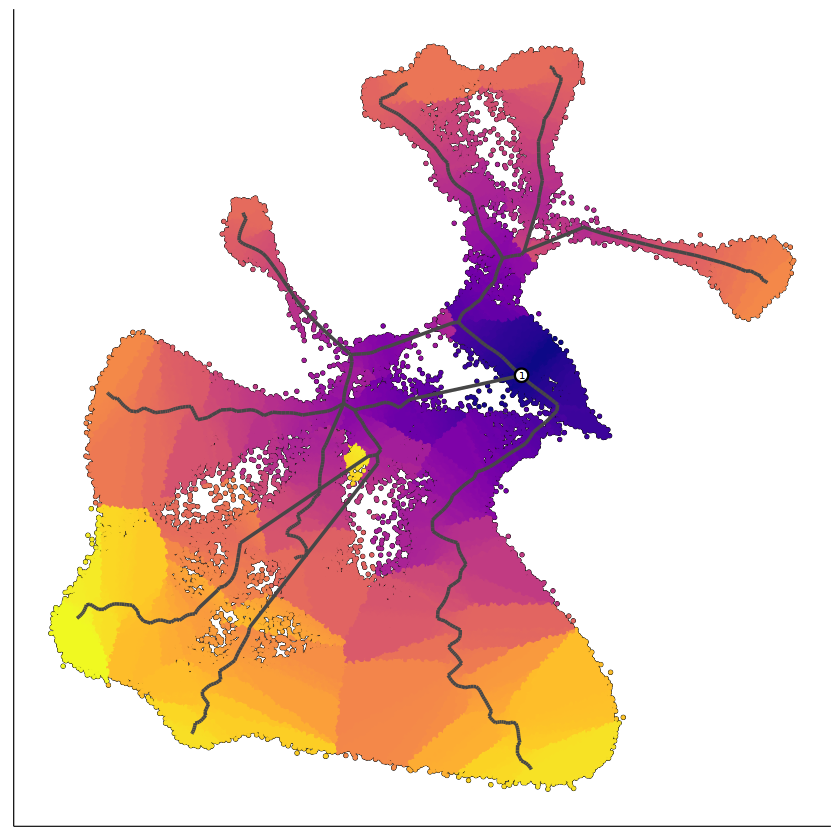

In [6]:
# midcolor
p_pseudotime <- plot_cells(cds, color_cells_by = "pseudotime", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F, label_cell_groups = F, cell_size = 0.5, cell_stroke = 0.3) + 
        theme(axis.text = element_blank(), 
          axis.ticks = element_blank(),
          axis.title = element_blank(), 
          panel.border = element_blank(),
          panel.grid.major = element_blank(),
          panel.grid.minor = element_blank(), 
          legend.position="none")
print(p_pseudotime)

In [ ]:
ggsave("en_umat_pseudotime.png", plot = p_pseudotime, width = 6, height = 6, dpi = 150)


In [ ]:
p_pseudotime_w_legend <- plot_cells(cds, color_cells_by = "pseudotime", label_leaves = F, label_branch_points = F, label_principal_points = F, label_groups_by_cluster = F, label_cell_groups = F, cell_size = 0.5, cell_stroke = 0.3) + 
        theme(axis.text = element_blank(), 
          axis.ticks = element_blank(),
          axis.title = element_blank(), 
          panel.border = element_blank(),
          panel.grid.major = element_blank(),
          panel.grid.minor = element_blank())

In [ ]:
ggsave("en_umat_pseudotime_legend.png", plot = p_pseudotime_w_legend, width = 6, height = 6, dpi = 150)


## Maturation rate of branches and lineages

### Regression of pseudotime along age

In [ ]:
pdf("en_mature_ratio_regression_branch.pdf", width = 4.5, height = 4.5)
regress_pt_along_age_branch(cds, "EN", c("Deep_nonIT", "Deep_IT", "Upper_IT"))
dev.off()

In [ ]:
pdf("en_mature_ratio_regression_lineage.pdf", width = 4.5, height = 4.5)
regress_pt_along_age(cds, "EN")
dev.off()

## Identify DEGs along trajectory

In [ ]:
%%sh

for sub_lineage in EN_L6B EN_L6_CT EN_L5_6_NP EN_L6_IT_1 EN_L6_IT_2 EN_L2_3_IT EN_L3_5_IT_1 EN_L3_5_IT_2 EN_L3_5_IT_3
do
    Rscript graph_test_Kriegstein_preprint.R \
        aging_lister_integrated_ds1000_rmno_scanpy6000_half_100_123456_beforeUMAT_EN_scanpy6000_25_sparse_123456_afterCombination_cds.RDS \
        ${sub_lineage} \
        3186 \
        0.05 \
        10000 \
        40 \
        aging_lister_integrated_ds1000_rmno_scanpy6000_half_100_123456_beforeUMAT_EN_scanpy6000_25_sparse_123456
done # for sub_lineage end

### Using modified moran test

In [ ]:
%%sh

for sub_lineage in EN_L6B EN_L6_CT EN_L5_6_NP EN_L6_IT_1 EN_L6_IT_2 EN_L2_3_IT EN_L3_5_IT_1 EN_L3_5_IT_2 EN_L3_5_IT_3
do
    Rscript modified_moran_test_lineage.R \
        aging_lister_integrated_ds1000_rmno_scanpy6000_half_100_123456_beforeUMAT_EN_scanpy6000_25_sparse_123456_afterCombination_cds.RDS \
        ${sub_lineage} \
        3186 \
        0.05 \
        10000 \
        40 \
        DEGs_moran_test/modified_10000/EN
done # for sub_lineage end

## Compress data along each lineage into 500 meta-cells

In [5]:
cds <- compress_lineages(cds, 3186, N = 500, cores = 40)
print(cds)
print(length(cds@expression))

[1] "EN_L6B"



Projecting cells to principal points for partition: 1



[1] "Window: 37.36"
[1] "Step: 37.28528"
[1] "Compressing lineage EN_L6B and fitting curves"


Loading required package: speedglm

Loading required package: Matrix


Attaching package: ‘Matrix’


The following objects are masked from ‘package:tidyr’:

    expand, pack, unpack


The following object is masked from ‘package:S4Vectors’:

    expand


Loading required package: MASS


Attaching package: ‘MASS’


The following object is masked from ‘package:dplyr’:

    select


Loading required package: biglm

Loading required package: DBI

Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of itera

[1] "EN_L6_CT"



Projecting cells to principal points for partition: 1



[1] "Window: 44.058"
[1] "Step: 43.969884"
[1] "Compressing lineage EN_L6_CT and fitting curves"


Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations 

[1] "EN_L5_6_NP"



Projecting cells to principal points for partition: 1



[1] "Window: 34.362"
[1] "Step: 34.293276"
[1] "Compressing lineage EN_L5_6_NP and fitting curves"


Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations 

[1] "EN_L6_IT_1"



Projecting cells to principal points for partition: 1



[1] "Window: 48.992"
[1] "Step: 48.894016"
[1] "Compressing lineage EN_L6_IT_1 and fitting curves"


Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”


[1] "EN_L6_IT_2"



Projecting cells to principal points for partition: 1



[1] "Window: 27.066"
[1] "Step: 27.011868"
[1] "Compressing lineage EN_L6_IT_2 and fitting curves"


Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations 

[1] "EN_L3_5_IT_1"



Projecting cells to principal points for partition: 1



[1] "Window: 52.194"
[1] "Step: 52.089612"
[1] "Compressing lineage EN_L3_5_IT_1 and fitting curves"


Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”


[1] "EN_L3_5_IT_2"



Projecting cells to principal points for partition: 1



[1] "Window: 98.792"
[1] "Step: 98.594416"
[1] "Compressing lineage EN_L3_5_IT_2 and fitting curves"


Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”
Warning message in speedglm(model, data = exp_data.sel, family = family, acc = 0.001, :
“Maximum number of iterations reached without convergence”


[1] "EN_L3_5_IT_3"



Projecting cells to principal points for partition: 1



[1] "Window: 81.566"
[1] "Step: 81.402868"
[1] "Compressing lineage EN_L3_5_IT_3 and fitting curves"
[1] "EN_L2_3_IT"



Projecting cells to principal points for partition: 1



[1] "Window: 151.806"
[1] "Step: 151.502388"
[1] "Compressing lineage EN_L2_3_IT and fitting curves"
class: cell_data_set_ext 
dim: 14649 349350 
metadata(0):
assays(2): counts logcounts
rownames(14649): DPM1 SCYL3 ... OOSP1 C8orf44-SGK3
rowData names(2): gene_name gene_short_name
colnames(349350): H1007-1-AAACGAAAGTTGTAGA-0-Aging
  H1007-1-AAACGCTAGGAACGTC-0-Aging ...
  TTTGTTGCAACAGTGG-RL2132_25yr_v3-Lister
  TTTGTTGGTTCGGCTG-RL2132_25yr_v3-Lister
colData names(55): orig.ident nCount_RNA ... ident Size_Factor
reducedDimNames(1): UMAP
mainExpName: RNA
altExpNames(0):
[1] 9


In [6]:
saveRDS(cds, file = "aging_lister_integrated_ds1000_rmno_scanpy6000_half_100_123456_beforeUMAT_EN_scanpy6000_25_sparse_123456_afterCombination_cds_compressed.RDS")
